# Face Generation

In this project, you'll define and train a Generative Adverserial network of your own creation on a dataset of faces. Your goal is to get a generator network to generate *new* images of faces that look as realistic as possible!

The project will be broken down into a series of tasks from **defining new architectures training adversarial networks**. At the end of the notebook, you'll be able to visualize the results of your trained Generator to see how it performs; your generated samples should look like fairly realistic faces with small amounts of noise.

### Get the Data

You'll be using the [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) to train your adversarial networks.

This dataset has higher resolution images than datasets you have previously worked with (like MNIST or SVHN) you've been working with, and so, you should prepare to define deeper networks and train them for a longer time to get good results. It is suggested that you utilize a GPU for training.

### Pre-processed Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. Some sample data is show below.

<img src='assets/processed_face_data.png' width=60% />

> If you are working locally, you can download this data [by clicking here](https://s3.amazonaws.com/video.udacity-data.com/topher/2018/November/5be7eb6f_processed-celeba-small/processed-celeba-small.zip)

This is a zip file that you'll need to extract in the home directory of this notebook for further loading and processing. After extracting the data, you should be left with a directory of data `processed-celeba-small/`.

In [ ]:
# run this once to unzip the file
!unzip processed-celeba-small.zip

In [1]:
from typing import Tuple, Callable

import matplotlib.pyplot as plt
import numpy as np
from torch.utils.data import DataLoader
from torchvision.transforms import (
    Compose,
    ToTensor,
    Normalize,
    Resize
)

import tests

In [2]:
data_dir = 'processed_celeba_small/celeba/'

## Data pipeline

The [CelebA](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations. Since you're going to be generating faces, you won't need the annotations, you'll only need the images. Note that these are color images with [3 color channels (RGB)](https://en.wikipedia.org/wiki/Channel_(digital_image)#RGB_Images) each.

### Pre-process and Load the Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. This *pre-processed* dataset is a smaller subset of the very large CelebA dataset and contains roughly 30,000 images. 

Your first task consists in building the dataloader. To do so, you need to do the following:
* implement the get_transforms function
* create a custom Dataset class that reads the CelebA data

### Exercise: implement the get_transforms function

The `get_transforms` function should output a [`torchvision.transforms.Compose`](https://pytorch.org/vision/stable/generated/torchvision.transforms.Compose.html#torchvision.transforms.Compose) of different transformations. You have two constraints:
* the function takes a tuple of size as input and should **resize the images** to the input size
* the output images should have values **ranging from -1 to 1**

In [3]:
# def get_transforms(size: Tuple[int, int]) -> Callable:
#     """ Transforms to apply to the image."""
#     # TODO: edit this function by appening transforms to the below list
#     transforms = [ToTensor()]
#     
#     return Compose(transforms)

def get_transforms(size: Tuple[int, int]) -> Callable:
    """
    Transforms to apply to the image.
    Args:
        size: Target size of the images
    Returns:
        Composition of transforms
    """
    transforms = [
        # Resize images to the specified size
        Resize(size),
        # Convert to tensor
        ToTensor(),
        # Normalize to range [-1, 1] as per GAN requirements
        Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ]
    return Compose(transforms)

### Exercise: implement the DatasetDirectory class


The `DatasetDirectory` class is a torch Dataset that reads from the above data directory. The `__getitem__` method should output a transformed tensor and the `__len__` method should output the number of files in our dataset. You can look at [this custom dataset](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html#creating-a-custom-dataset-for-your-files) for ideas. 

In [4]:
# class DatasetDirectory(Dataset):
#     """
#     A custom dataset class that loads images from folder.
#     args:
#     - directory: location of the images
#     - transform: transform function to apply to the images
#     - extension: file format
#     """
#     def __init__(self, 
#                  directory: str, 
#                  transforms: Callable = None, 
#                  extension: str = '.jpg'):
#         # TODO: implement the init method
# 
#     def __len__(self) -> int:
#         """ returns the number of items in the dataset """
#         # TODO: return the number of elements in the dataset
#         return 
# 
#     def __getitem__(self, index: int) -> torch.Tensor:
#         """ load an image and apply transformation """
#         # TODO: return the index-element of the dataset
#         return 

from PIL import Image
import torch
from torch.utils.data import Dataset
import os
from typing import Callable

class DatasetDirectory(Dataset):
    def __init__(self, directory: str, transforms: Callable = None, extension: str = '.jpg'):
        """Initialize dataset with directory of images."""
        self.directory = directory
        self.image_files = sorted([
            os.path.join(directory, f) 
            for f in os.listdir(directory) 
            if f.endswith(extension)
        ])
        
        # Default transform if none provided
        self.transforms = transforms if transforms else get_transforms((64, 64))

    def __len__(self) -> int:
        return len(self.image_files)

    def __getitem__(self, index: int) -> torch.Tensor:
        """Get a single image."""
        # Get image path
        image_path = self.image_files[index]
        
        # Load and convert image to RGB
        image = Image.open(image_path).convert('RGB')
        
        # Apply transforms
        if self.transforms:
            image = self.transforms(image)
            
        return image

# def get_transforms(size: Tuple[int, int]) -> Callable:
#     """
#     Create transform pipeline.
#     Size should be (64, 64) for this project.
#     """
#     return transforms.Compose([
#         transforms.Resize(size),
#         transforms.ToTensor(),
#         transforms.Normalize(mean=[0.5, 0.5, 0.5], 
#                            std=[0.5, 0.5, 0.5])  # This scales to [-1, 1]
#     ])

In [5]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your dataset implementation
dataset = DatasetDirectory(data_dir, get_transforms((64, 64)))
tests.check_dataset_outputs(dataset)

Congrats, your dataset implementation passed all the tests


The functions below will help you visualize images from the dataset.

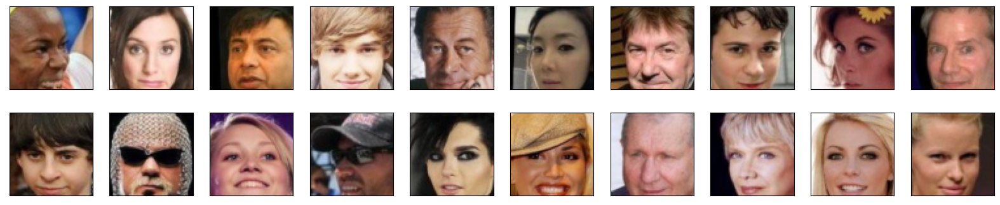

In [6]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def denormalize(images):
    """Transform images from [-1.0, 1.0] to [0, 255] and cast them to uint8."""
    return ((images + 1.) / 2. * 255).astype(np.uint8)

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(20, 4))
plot_size=20
for idx in np.arange(plot_size):
    ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
    img = dataset[idx].numpy()
    img = np.transpose(img, (1, 2, 0))
    img = denormalize(img)
    ax.imshow(img)

## Model implementation

As you know, a GAN is comprised of two adversarial networks, a discriminator and a generator. Now that we have a working data pipeline, we need to implement the discriminator and the generator. 

Feel free to implement any additional class or function.

### Exercise: Create the discriminator

The discriminator's job is to score real and fake images. You have two constraints here:
* the discriminator takes as input a **batch of 64x64x3 images**
* the output should be a single value (=score)

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips
* To scale down from the input image, you can either use `Conv2d` layers with the correct hyperparameters or Pooling layers.
* If you plan on using gradient penalty, do not use Batch Normalization layers in the discriminator.

In [7]:
from torch.nn import Module
import torch
import torch.nn as nn


In [8]:
# class Discriminator(Module):
#     def __init__(self):
#         super(Discriminator, self).__init__()
#         # TODO: instantiate the different layers
        
#     def forward(self, x: torch.Tensor) -> torch.Tensor:
#         # TODO: implement the forward method
#         return x 


class Discriminator(Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        # DCGAN-style discriminator
        self.main = nn.Sequential(
            # Input: 3x64x64
            nn.Conv2d(3, 64, 4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
            # 64x32x32
            nn.Conv2d(64, 128, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            
            # 128x16x16
            nn.Conv2d(128, 256, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            
            # 256x8x8
            nn.Conv2d(256, 512, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            
            # 512x4x4 -> 1x1x1x1
            nn.Conv2d(512, 1, 4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
        )
        
    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.main(x).view(-1, 1, 1, 1)


In [9]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to check your discriminator implementation
discriminator = Discriminator()
tests.check_discriminator(discriminator)

Congrats, your discriminator implementation passed all the tests


### Exercise: create the generator

The generator's job creates the "fake images" and learns the dataset distribution. You have three constraints here:
* the generator takes as input a vector of dimension `[batch_size, latent_dimension, 1, 1]`
* the generator must outputs **64x64x3 images**

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips:
* to scale up from the latent vector input, you can use `ConvTranspose2d` layers
* as often with Gan, **Batch Normalization** helps with training

In [10]:
# class Generator(Module):
#     def __init__(self, latent_dim: int):
#         super(Generator, self).__init__()
#         # TODO: instantiate the different layers

#     def forward(self, x: torch.Tensor) -> torch.Tensor:
#         # TODO: implement the forward method
#         return x


class Generator(Module):
    def __init__(self, latent_dim: int):
        super(Generator, self).__init__()
        
        self.main = nn.Sequential(
            # Input: latent_dim x 1 x 1
            nn.ConvTranspose2d(latent_dim, 512, 4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            
            # 512 x 4 x 4
            nn.ConvTranspose2d(512, 256, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            
            # 256 x 8 x 8
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            
            # 128 x 16 x 16
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            
            # 64 x 32 x 32
            nn.ConvTranspose2d(64, 3, 4, stride=2, padding=1, bias=False),
            nn.Tanh()
            # Output: 3 x 64 x 64
        )
        
    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.main(x)

In [11]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your generator implementation
# latent_dim = 128
latent_dim = 256
generator = Generator(latent_dim)
tests.check_generator(generator, latent_dim)

Congrats, your generator implementation passed all the tests


## Optimizer

In the following section, we create the optimizers for the generator and discriminator. You may want to experiment with different optimizers, learning rates and other hyperparameters as they tend to impact the output quality.

### Exercise: implement the optimizers

In [12]:
import torch.optim as optim


# def create_optimizers(generator: Module, discriminator: Module):
#     """ This function should return the optimizers of the generator and the discriminator """
#     # TODO: implement the generator and discriminator optimizers
#     g_optimizer = 
#     d_optimizer =
#     return g_optimizer, d_optimizer


def create_optimizers(generator: Module, discriminator: Module):
    """Creates optimizers for generator and discriminator"""
    g_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    return g_optimizer, d_optimizer

## Losses implementation

In this section, we are going to implement the loss function for the generator and the discriminator. You can and should experiment with different loss function.

Some tips:
* You can choose the commonly used the binary cross entropy loss or select other losses we have discovered in the course, such as the Wasserstein distance.
* You may want to implement a gradient penalty function as discussed in the course. It is not required and the code will work whether you implement it or not.

### Exercise: implement the generator loss

The generator's goal is to get the discriminator to think its generated images (= "fake" images) are real.

In [13]:
# def generator_loss(fake_logits):
#     """ Generator loss, takes the fake scores as inputs. """
#     # TODO: implement the generator loss 
#     return loss


def generator_loss(fake_logits):
    """Generator loss"""
    criterion = nn.BCELoss()
    # Generate labels for fake images as if they were real
    labels = torch.ones_like(fake_logits)
    return criterion(fake_logits, labels)



### Exercise: implement the discriminator loss

We want the discriminator to give high scores to real images and low scores to fake ones and the discriminator loss should reflect that.

In [14]:
# def discriminator_loss(real_logits, fake_logits):
#     """ Discriminator loss, takes the fake and real logits as inputs. """
#     # TODO: implement the discriminator loss 
#     return loss

def discriminator_loss(real_logits, fake_logits):
    """Discriminator loss"""
    criterion = nn.BCELoss()
    # Real images should be labeled as 1
    real_labels = torch.ones_like(real_logits)
    # Fake images should be labeled as 0
    fake_labels = torch.zeros_like(fake_logits)
    
    real_loss = criterion(real_logits, real_labels)
    fake_loss = criterion(fake_logits, fake_labels)
    
    return real_loss + fake_loss

### Exercise (Optional): Implement the gradient Penalty

In the course, we discussed the importance of gradient penalty in training certain types of Gans. Implementing this function is not required and depends on some of the design decision you made (discriminator architecture, loss functions).

In [ ]:
def gradient_penalty(discriminator, real_samples, fake_samples):
    """ This function enforces """
    gp = 0
    # TODO (Optional): implement the gradient penalty
    return gp

## Training


Training will involve alternating between training the discriminator and the generator. You'll use your functions real_loss and fake_loss to help you calculate the discriminator losses.

* You should train the discriminator by alternating on real and fake images
* Then the generator, which tries to trick the discriminator and should have an opposing loss function

### Exercise: implement the generator step and the discriminator step functions

Each function should do the following:
* calculate the loss
* backpropagate the gradient
* perform one optimizer step

In [15]:
# def generator_step(batch_size: int, latent_dim: int) -> Dict:
#     """ One training step of the generator. """
#     # TODO: implement the generator step (foward pass, loss calculation and backward pass)
#     return {'loss': g_loss}


# def discriminator_step(batch_size: int, latent_dim: int, real_images: torch.Tensor) -> Dict:
#     """ One training step of the discriminator. """
#     # TODO: implement the discriminator step (foward pass, loss calculation and backward pass)
#     return {'loss': d_loss, 'gp': gp}


def generator_step(generator, discriminator, g_optimizer, batch_size, latent_dim, device):
    """One training step for generator"""
    g_optimizer.zero_grad()
    
    # Generate fake images
    noise = torch.randn(batch_size, latent_dim, 1, 1, device=device)
    fake_images = generator(noise)
    
    # Get discriminator output on fake images
    fake_logits = discriminator(fake_images)
    
    # Calculate generator loss
    g_loss = generator_loss(fake_logits)
    
    # Backpropagate and update
    g_loss.backward()
    g_optimizer.step()
    
    return {'loss': g_loss}

def discriminator_step(generator, discriminator, d_optimizer, batch_size, latent_dim, real_images, device):
    """One training step for discriminator"""
    d_optimizer.zero_grad()
    
    # Get discriminator output on real images
    real_logits = discriminator(real_images)
    
    # Generate and get output on fake images
    noise = torch.randn(batch_size, latent_dim, 1, 1, device=device)
    with torch.no_grad():
        fake_images = generator(noise)
    fake_logits = discriminator(fake_images)
    
    # Calculate discriminator loss
    d_loss = discriminator_loss(real_logits, fake_logits)
    
    # Backpropagate and update
    d_loss.backward()
    d_optimizer.step()
    
    return {'loss': d_loss}

### Main training loop

You don't have to implement anything here but you can experiment with different hyperparameters.

In [16]:
# # you can experiment with different dimensions of latent spaces
# latent_dim = 128
# 
# # update to cpu if you do not have access to a gpu
# # device = 'cuda'
# 
# # Device selection
# if torch.cuda.is_available():
#     device = 'cuda'  # For machines with NVIDIA GPUs
# elif torch.backends.mps.is_available():
#     device = 'mps'  # For Apple M1/M2 (Metal Performance Shaders)
# else:
#     device = 'cpu'  # Fallback to CPU if no compatible hardware acceleration is available
# 
# print(f"Using device: {device}")
# 
# 
# # number of epochs to train your model
# n_epochs = 50
# 
# # number of images in each batch
# batch_size = 64


# Experiment with a larger latent dimension
latent_dim = 256  # Try increasing to 256 or 512

# Device selection (retain as-is for best performance)
if torch.cuda.is_available():
    device = 'cuda'  # For NVIDIA GPUs
elif torch.backends.mps.is_available():
    device = 'mps'  # For Apple M1/M2 (Metal Performance Shaders)
else:
    device = 'cpu'  # Fallback to CPU if no compatible hardware acceleration is available

print(f"Using device: {device}")

# Increase the number of epochs for better convergence
n_epochs = 50  # Increase for more training time

# Try increasing batch size if memory allows
batch_size = 128  # Larger batch sizes stabilize training (reduce if memory is limited)


Using device: mps


In [17]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
print_every = 50

# Create optimizers for the discriminator D and generator G
generator = Generator(latent_dim).to(device)
discriminator = Discriminator().to(device)
g_optimizer, d_optimizer = create_optimizers(generator, discriminator)

dataloader = DataLoader(dataset, 
                        batch_size=64, 
                        shuffle=True, 
                        num_workers=0, 
                        drop_last=True,
                        pin_memory=False)

In [18]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def display(fixed_latent_vector: torch.Tensor):
    """ helper function to display images during training """
    fig = plt.figure(figsize=(14, 4))
    plot_size = 16
    for idx in np.arange(plot_size):
        ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
        img = fixed_latent_vector[idx, ...].detach().cpu().numpy()
        img = np.transpose(img, (1, 2, 0))
        img = denormalize(img)
        ax.imshow(img)
    plt.show()

### Exercise: implement the training strategy

You should experiment with different training strategies. For example:

* train the generator more often than the discriminator. 
* added noise to the input image
* use label smoothing

Implement with your training strategy below.

Starting Epoch [1/50]...
2024-11-01 14:17:24 | Epoch [1/50] | Batch 0/509 | d_loss: 1.4872 | g_loss: 1.7512
2024-11-01 14:17:30 | Epoch [1/50] | Batch 50/509 | d_loss: 0.0144 | g_loss: 15.3055
2024-11-01 14:17:35 | Epoch [1/50] | Batch 100/509 | d_loss: 0.3232 | g_loss: 5.8258
2024-11-01 14:17:41 | Epoch [1/50] | Batch 150/509 | d_loss: 1.0750 | g_loss: 6.7188
2024-11-01 14:17:47 | Epoch [1/50] | Batch 200/509 | d_loss: 0.5774 | g_loss: 4.1548
2024-11-01 14:17:52 | Epoch [1/50] | Batch 250/509 | d_loss: 0.5771 | g_loss: 4.5398
2024-11-01 14:17:58 | Epoch [1/50] | Batch 300/509 | d_loss: 0.4006 | g_loss: 3.0326
2024-11-01 14:18:04 | Epoch [1/50] | Batch 350/509 | d_loss: 0.4515 | g_loss: 3.7981
2024-11-01 14:18:09 | Epoch [1/50] | Batch 400/509 | d_loss: 0.6176 | g_loss: 2.0283
2024-11-01 14:18:15 | Epoch [1/50] | Batch 450/509 | d_loss: 3.2592 | g_loss: 5.4137
2024-11-01 14:18:21 | Epoch [1/50] | Batch 500/509 | d_loss: 0.2570 | g_loss: 2.0860
End of Epoch [1/50]. Generating sample ima

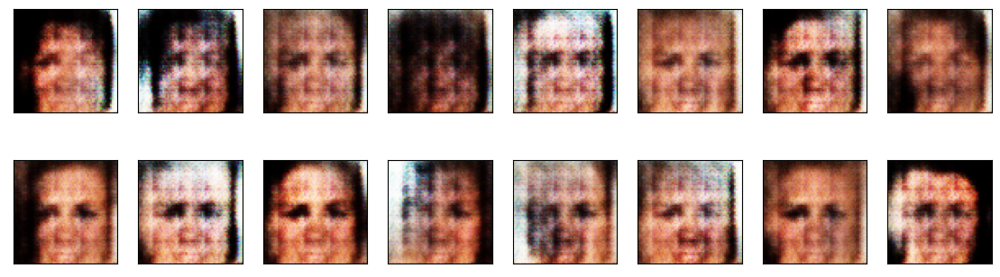

Starting Epoch [2/50]...
2024-11-01 14:18:22 | Epoch [2/50] | Batch 0/509 | d_loss: 0.3563 | g_loss: 3.9097
2024-11-01 14:18:28 | Epoch [2/50] | Batch 50/509 | d_loss: 0.1222 | g_loss: 3.0002
2024-11-01 14:18:33 | Epoch [2/50] | Batch 100/509 | d_loss: 0.2381 | g_loss: 4.6396
2024-11-01 14:18:39 | Epoch [2/50] | Batch 150/509 | d_loss: 0.3281 | g_loss: 3.7388
2024-11-01 14:18:45 | Epoch [2/50] | Batch 200/509 | d_loss: 0.4590 | g_loss: 2.7828
2024-11-01 14:18:50 | Epoch [2/50] | Batch 250/509 | d_loss: 0.5304 | g_loss: 3.4480
2024-11-01 14:18:56 | Epoch [2/50] | Batch 300/509 | d_loss: 0.4309 | g_loss: 3.5260
2024-11-01 14:19:02 | Epoch [2/50] | Batch 350/509 | d_loss: 0.3730 | g_loss: 4.5056
2024-11-01 14:19:07 | Epoch [2/50] | Batch 400/509 | d_loss: 0.5322 | g_loss: 6.7418
2024-11-01 14:19:13 | Epoch [2/50] | Batch 450/509 | d_loss: 0.3222 | g_loss: 3.9414
2024-11-01 14:19:19 | Epoch [2/50] | Batch 500/509 | d_loss: 0.5901 | g_loss: 4.1906
End of Epoch [2/50]. Generating sample imag

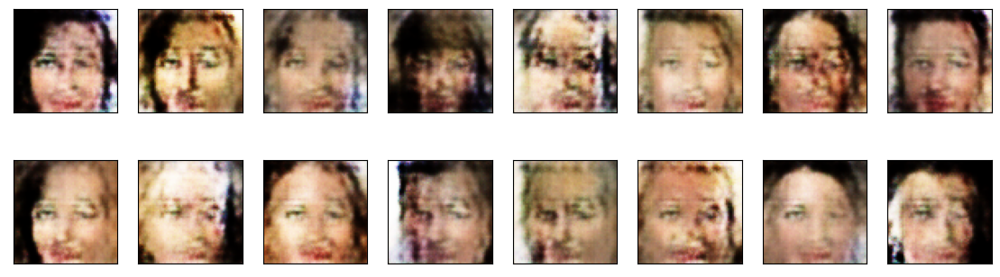

Starting Epoch [3/50]...
2024-11-01 14:19:20 | Epoch [3/50] | Batch 0/509 | d_loss: 1.2425 | g_loss: 3.7143
2024-11-01 14:19:26 | Epoch [3/50] | Batch 50/509 | d_loss: 0.4463 | g_loss: 3.6428
2024-11-01 14:19:32 | Epoch [3/50] | Batch 100/509 | d_loss: 0.6135 | g_loss: 5.2815
2024-11-01 14:19:37 | Epoch [3/50] | Batch 150/509 | d_loss: 0.2470 | g_loss: 3.6196
2024-11-01 14:19:43 | Epoch [3/50] | Batch 200/509 | d_loss: 0.4289 | g_loss: 3.0344
2024-11-01 14:19:49 | Epoch [3/50] | Batch 250/509 | d_loss: 0.4257 | g_loss: 4.0377
2024-11-01 14:19:54 | Epoch [3/50] | Batch 300/509 | d_loss: 1.2311 | g_loss: 1.1538
2024-11-01 14:20:00 | Epoch [3/50] | Batch 350/509 | d_loss: 0.3289 | g_loss: 4.2322
2024-11-01 14:20:06 | Epoch [3/50] | Batch 400/509 | d_loss: 0.5164 | g_loss: 2.4623
2024-11-01 14:20:12 | Epoch [3/50] | Batch 450/509 | d_loss: 0.3701 | g_loss: 7.7782
2024-11-01 14:20:18 | Epoch [3/50] | Batch 500/509 | d_loss: 1.0346 | g_loss: 3.7519
End of Epoch [3/50]. Generating sample imag

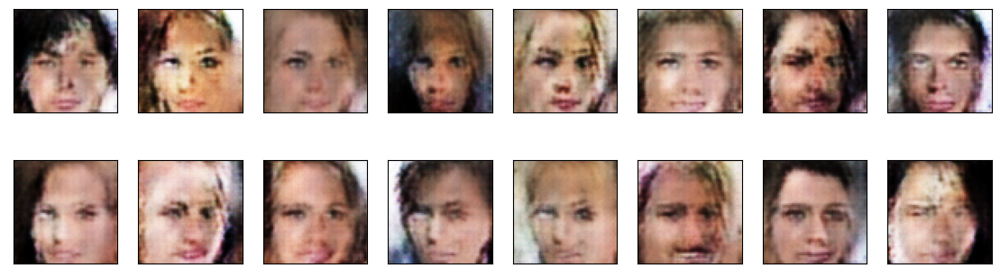

Starting Epoch [4/50]...
2024-11-01 14:20:19 | Epoch [4/50] | Batch 0/509 | d_loss: 0.4254 | g_loss: 3.9346
2024-11-01 14:20:25 | Epoch [4/50] | Batch 50/509 | d_loss: 0.3459 | g_loss: 4.0223
2024-11-01 14:20:32 | Epoch [4/50] | Batch 100/509 | d_loss: 0.3950 | g_loss: 2.4810
2024-11-01 14:20:38 | Epoch [4/50] | Batch 150/509 | d_loss: 0.4016 | g_loss: 3.2975
2024-11-01 14:20:45 | Epoch [4/50] | Batch 200/509 | d_loss: 0.3408 | g_loss: 5.2449
2024-11-01 14:20:51 | Epoch [4/50] | Batch 250/509 | d_loss: 0.2030 | g_loss: 4.4192
2024-11-01 14:20:58 | Epoch [4/50] | Batch 300/509 | d_loss: 0.2712 | g_loss: 3.4341
2024-11-01 14:21:05 | Epoch [4/50] | Batch 350/509 | d_loss: 0.3481 | g_loss: 4.3992
2024-11-01 14:21:12 | Epoch [4/50] | Batch 400/509 | d_loss: 0.1722 | g_loss: 3.5909
2024-11-01 14:21:19 | Epoch [4/50] | Batch 450/509 | d_loss: 0.5270 | g_loss: 5.5407
2024-11-01 14:21:26 | Epoch [4/50] | Batch 500/509 | d_loss: 0.2233 | g_loss: 5.2915
End of Epoch [4/50]. Generating sample imag

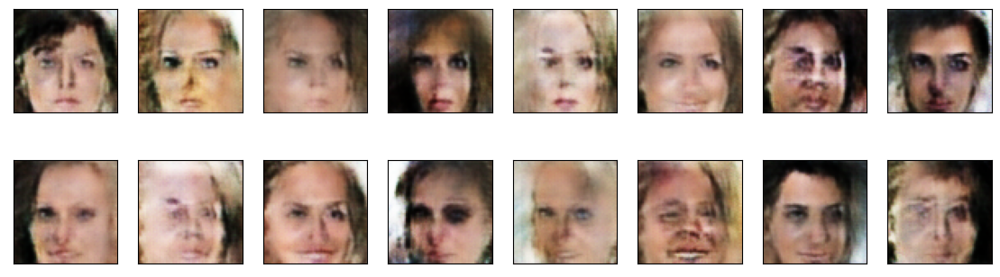

Starting Epoch [5/50]...
2024-11-01 14:21:28 | Epoch [5/50] | Batch 0/509 | d_loss: 0.3253 | g_loss: 3.5421
2024-11-01 14:21:35 | Epoch [5/50] | Batch 50/509 | d_loss: 0.3180 | g_loss: 3.8870
2024-11-01 14:21:42 | Epoch [5/50] | Batch 100/509 | d_loss: 0.2078 | g_loss: 4.2141
2024-11-01 14:21:50 | Epoch [5/50] | Batch 150/509 | d_loss: 0.6159 | g_loss: 3.5979
2024-11-01 14:21:57 | Epoch [5/50] | Batch 200/509 | d_loss: 0.7046 | g_loss: 6.9627
2024-11-01 14:22:05 | Epoch [5/50] | Batch 250/509 | d_loss: 0.4162 | g_loss: 2.6002
2024-11-01 14:22:12 | Epoch [5/50] | Batch 300/509 | d_loss: 0.3059 | g_loss: 3.3723
2024-11-01 14:22:20 | Epoch [5/50] | Batch 350/509 | d_loss: 0.3251 | g_loss: 5.1103
2024-11-01 14:22:28 | Epoch [5/50] | Batch 400/509 | d_loss: 0.3252 | g_loss: 6.6154
2024-11-01 14:22:36 | Epoch [5/50] | Batch 450/509 | d_loss: 0.2410 | g_loss: 3.2703
2024-11-01 14:22:44 | Epoch [5/50] | Batch 500/509 | d_loss: 0.1901 | g_loss: 4.6546
End of Epoch [5/50]. Generating sample imag

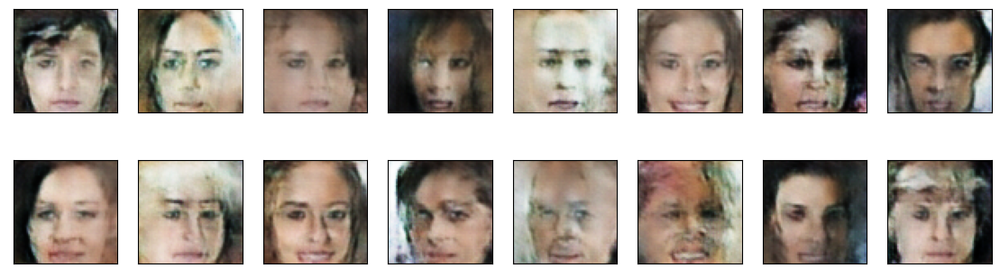

Starting Epoch [6/50]...
2024-11-01 14:22:46 | Epoch [6/50] | Batch 0/509 | d_loss: 0.1040 | g_loss: 3.3838
2024-11-01 14:22:54 | Epoch [6/50] | Batch 50/509 | d_loss: 0.3847 | g_loss: 3.6562
2024-11-01 14:23:02 | Epoch [6/50] | Batch 100/509 | d_loss: 0.5612 | g_loss: 3.5351
2024-11-01 14:23:10 | Epoch [6/50] | Batch 150/509 | d_loss: 0.3808 | g_loss: 6.7807
2024-11-01 14:23:19 | Epoch [6/50] | Batch 200/509 | d_loss: 0.1855 | g_loss: 4.1677
2024-11-01 14:23:27 | Epoch [6/50] | Batch 250/509 | d_loss: 0.2338 | g_loss: 2.5236
2024-11-01 14:23:36 | Epoch [6/50] | Batch 300/509 | d_loss: 0.3245 | g_loss: 2.7933
2024-11-01 14:23:44 | Epoch [6/50] | Batch 350/509 | d_loss: 0.0660 | g_loss: 4.8047
2024-11-01 14:23:53 | Epoch [6/50] | Batch 400/509 | d_loss: 0.7726 | g_loss: 9.2857
2024-11-01 14:24:01 | Epoch [6/50] | Batch 450/509 | d_loss: 0.2819 | g_loss: 3.8675
2024-11-01 14:24:10 | Epoch [6/50] | Batch 500/509 | d_loss: 0.7240 | g_loss: 3.8759
End of Epoch [6/50]. Generating sample imag

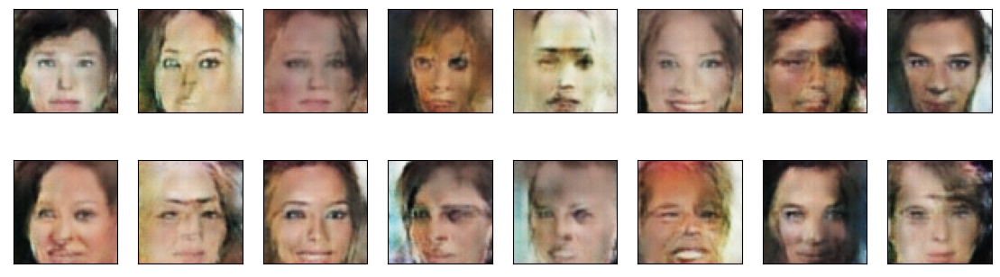

Starting Epoch [7/50]...
2024-11-01 14:24:12 | Epoch [7/50] | Batch 0/509 | d_loss: 0.0801 | g_loss: 3.9901
2024-11-01 14:24:20 | Epoch [7/50] | Batch 50/509 | d_loss: 0.3518 | g_loss: 5.5166
2024-11-01 14:24:29 | Epoch [7/50] | Batch 100/509 | d_loss: 0.3216 | g_loss: 5.7736
2024-11-01 14:24:37 | Epoch [7/50] | Batch 150/509 | d_loss: 0.1941 | g_loss: 4.9174
2024-11-01 14:24:46 | Epoch [7/50] | Batch 200/509 | d_loss: 0.3208 | g_loss: 7.3797
2024-11-01 14:24:54 | Epoch [7/50] | Batch 250/509 | d_loss: 0.2518 | g_loss: 4.3586
2024-11-01 14:25:03 | Epoch [7/50] | Batch 300/509 | d_loss: 0.2658 | g_loss: 4.1747
2024-11-01 14:25:11 | Epoch [7/50] | Batch 350/509 | d_loss: 0.3307 | g_loss: 4.7168
2024-11-01 14:25:20 | Epoch [7/50] | Batch 400/509 | d_loss: 0.0438 | g_loss: 3.3572
2024-11-01 14:25:29 | Epoch [7/50] | Batch 450/509 | d_loss: 0.7827 | g_loss: 5.8068
2024-11-01 14:25:37 | Epoch [7/50] | Batch 500/509 | d_loss: 0.0567 | g_loss: 8.8044
End of Epoch [7/50]. Generating sample imag

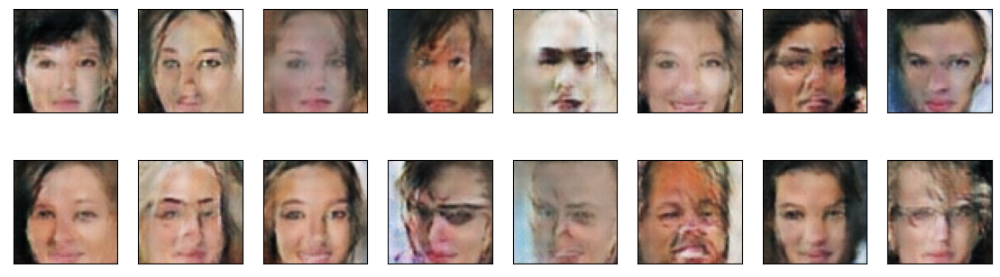

Starting Epoch [8/50]...
2024-11-01 14:25:39 | Epoch [8/50] | Batch 0/509 | d_loss: 0.0087 | g_loss: 5.6684
2024-11-01 14:25:47 | Epoch [8/50] | Batch 50/509 | d_loss: 0.1378 | g_loss: 4.2553
2024-11-01 14:25:56 | Epoch [8/50] | Batch 100/509 | d_loss: 0.0465 | g_loss: 5.1118
2024-11-01 14:26:04 | Epoch [8/50] | Batch 150/509 | d_loss: 0.3524 | g_loss: 3.0802
2024-11-01 14:26:12 | Epoch [8/50] | Batch 200/509 | d_loss: 0.2601 | g_loss: 3.0193
2024-11-01 14:26:21 | Epoch [8/50] | Batch 250/509 | d_loss: 0.0879 | g_loss: 4.3831
2024-11-01 14:26:29 | Epoch [8/50] | Batch 300/509 | d_loss: 0.1037 | g_loss: 11.8312
2024-11-01 14:26:37 | Epoch [8/50] | Batch 350/509 | d_loss: 0.2045 | g_loss: 2.1808
2024-11-01 14:26:46 | Epoch [8/50] | Batch 400/509 | d_loss: 0.1242 | g_loss: 4.8037
2024-11-01 14:26:55 | Epoch [8/50] | Batch 450/509 | d_loss: 0.0085 | g_loss: 8.8897
2024-11-01 14:27:03 | Epoch [8/50] | Batch 500/509 | d_loss: 0.2086 | g_loss: 6.5766
End of Epoch [8/50]. Generating sample ima

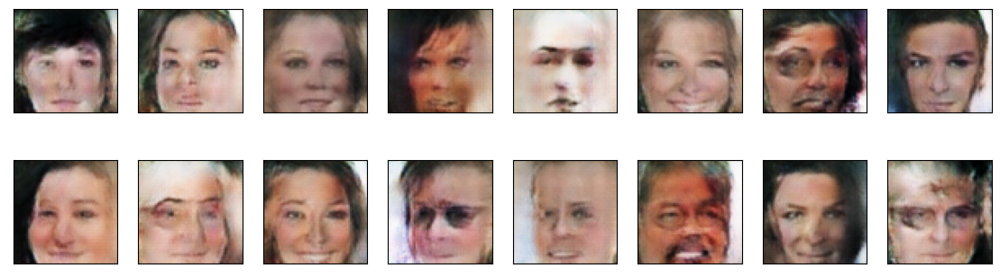

Starting Epoch [9/50]...
2024-11-01 14:27:05 | Epoch [9/50] | Batch 0/509 | d_loss: 1.6399 | g_loss: 9.1867
2024-11-01 14:27:13 | Epoch [9/50] | Batch 50/509 | d_loss: 1.3230 | g_loss: 8.4925
2024-11-01 14:27:21 | Epoch [9/50] | Batch 100/509 | d_loss: 0.8931 | g_loss: 8.4243
2024-11-01 14:27:30 | Epoch [9/50] | Batch 150/509 | d_loss: 0.1507 | g_loss: 4.4559
2024-11-01 14:27:38 | Epoch [9/50] | Batch 200/509 | d_loss: 0.0141 | g_loss: 5.3251
2024-11-01 14:27:46 | Epoch [9/50] | Batch 250/509 | d_loss: 0.4670 | g_loss: 6.6975
2024-11-01 14:27:54 | Epoch [9/50] | Batch 300/509 | d_loss: 0.0584 | g_loss: 9.3797
2024-11-01 14:28:02 | Epoch [9/50] | Batch 350/509 | d_loss: 0.1915 | g_loss: 6.7776
2024-11-01 14:28:10 | Epoch [9/50] | Batch 400/509 | d_loss: 0.4098 | g_loss: 6.1474
2024-11-01 14:28:19 | Epoch [9/50] | Batch 450/509 | d_loss: 0.1771 | g_loss: 7.0675
2024-11-01 14:28:27 | Epoch [9/50] | Batch 500/509 | d_loss: 0.1342 | g_loss: 4.5806
End of Epoch [9/50]. Generating sample imag

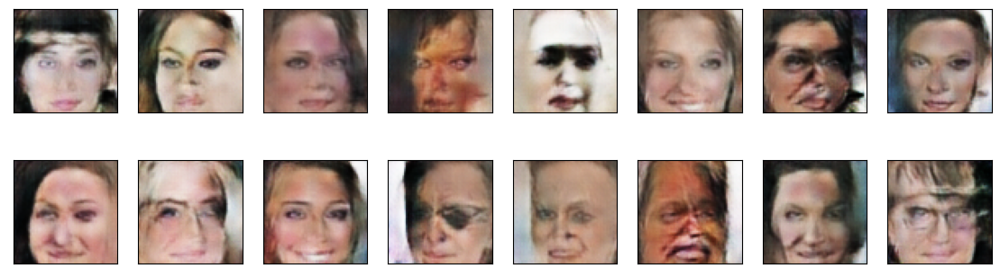

Starting Epoch [10/50]...
2024-11-01 14:28:29 | Epoch [10/50] | Batch 0/509 | d_loss: 0.0355 | g_loss: 4.6620
2024-11-01 14:28:37 | Epoch [10/50] | Batch 50/509 | d_loss: 0.0753 | g_loss: 4.8666
2024-11-01 14:28:46 | Epoch [10/50] | Batch 100/509 | d_loss: 0.0267 | g_loss: 6.3140
2024-11-01 14:28:54 | Epoch [10/50] | Batch 150/509 | d_loss: 0.0874 | g_loss: 3.1820
2024-11-01 14:29:02 | Epoch [10/50] | Batch 200/509 | d_loss: 0.0389 | g_loss: 5.6192
2024-11-01 14:29:10 | Epoch [10/50] | Batch 250/509 | d_loss: 0.0252 | g_loss: 5.1284
2024-11-01 14:29:18 | Epoch [10/50] | Batch 300/509 | d_loss: 0.1295 | g_loss: 4.6082
2024-11-01 14:29:26 | Epoch [10/50] | Batch 350/509 | d_loss: 0.1245 | g_loss: 3.5140
2024-11-01 14:29:34 | Epoch [10/50] | Batch 400/509 | d_loss: 0.0311 | g_loss: 8.7047
2024-11-01 14:29:42 | Epoch [10/50] | Batch 450/509 | d_loss: 0.3555 | g_loss: 3.7165
2024-11-01 14:29:50 | Epoch [10/50] | Batch 500/509 | d_loss: 0.3920 | g_loss: 5.9589
End of Epoch [10/50]. Generatin

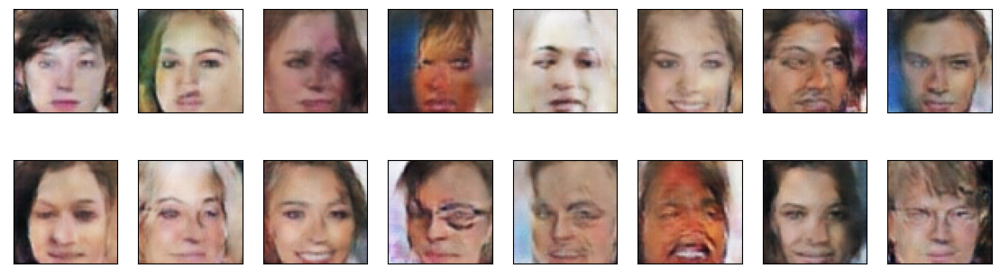

Starting Epoch [11/50]...
2024-11-01 14:29:52 | Epoch [11/50] | Batch 0/509 | d_loss: 0.0105 | g_loss: 9.4495
2024-11-01 14:30:00 | Epoch [11/50] | Batch 50/509 | d_loss: 0.1667 | g_loss: 6.6562
2024-11-01 14:30:08 | Epoch [11/50] | Batch 100/509 | d_loss: 0.1497 | g_loss: 3.4392
2024-11-01 14:30:16 | Epoch [11/50] | Batch 150/509 | d_loss: 0.0248 | g_loss: 7.6846
2024-11-01 14:30:25 | Epoch [11/50] | Batch 200/509 | d_loss: 0.0055 | g_loss: 5.3288
2024-11-01 14:30:33 | Epoch [11/50] | Batch 250/509 | d_loss: 0.0664 | g_loss: 4.4097
2024-11-01 14:30:41 | Epoch [11/50] | Batch 300/509 | d_loss: 0.0696 | g_loss: 4.7542
2024-11-01 14:30:49 | Epoch [11/50] | Batch 350/509 | d_loss: 0.4839 | g_loss: 5.6900
2024-11-01 14:30:57 | Epoch [11/50] | Batch 400/509 | d_loss: 0.0710 | g_loss: 3.5638
2024-11-01 14:31:05 | Epoch [11/50] | Batch 450/509 | d_loss: 0.2199 | g_loss: 4.1522
2024-11-01 14:31:14 | Epoch [11/50] | Batch 500/509 | d_loss: 0.0452 | g_loss: 3.6443
End of Epoch [11/50]. Generatin

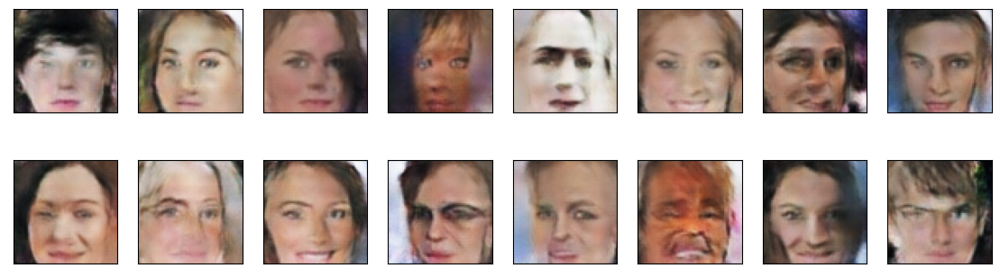

Starting Epoch [12/50]...
2024-11-01 14:31:16 | Epoch [12/50] | Batch 0/509 | d_loss: 0.1583 | g_loss: 3.8088
2024-11-01 14:31:24 | Epoch [12/50] | Batch 50/509 | d_loss: 0.0127 | g_loss: 8.4229
2024-11-01 14:31:32 | Epoch [12/50] | Batch 100/509 | d_loss: 0.0037 | g_loss: 7.2548
2024-11-01 14:31:40 | Epoch [12/50] | Batch 150/509 | d_loss: 0.0289 | g_loss: 4.6841
2024-11-01 14:31:48 | Epoch [12/50] | Batch 200/509 | d_loss: 1.7972 | g_loss: 6.6375
2024-11-01 14:31:56 | Epoch [12/50] | Batch 250/509 | d_loss: 0.3732 | g_loss: 7.8248
2024-11-01 14:32:04 | Epoch [12/50] | Batch 300/509 | d_loss: 0.0240 | g_loss: 6.4591
2024-11-01 14:32:12 | Epoch [12/50] | Batch 350/509 | d_loss: 0.0297 | g_loss: 4.7222
2024-11-01 14:32:20 | Epoch [12/50] | Batch 400/509 | d_loss: 0.0429 | g_loss: 5.2641
2024-11-01 14:32:28 | Epoch [12/50] | Batch 450/509 | d_loss: 0.0312 | g_loss: 5.8752
2024-11-01 14:32:37 | Epoch [12/50] | Batch 500/509 | d_loss: 0.0725 | g_loss: 4.1480
End of Epoch [12/50]. Generatin

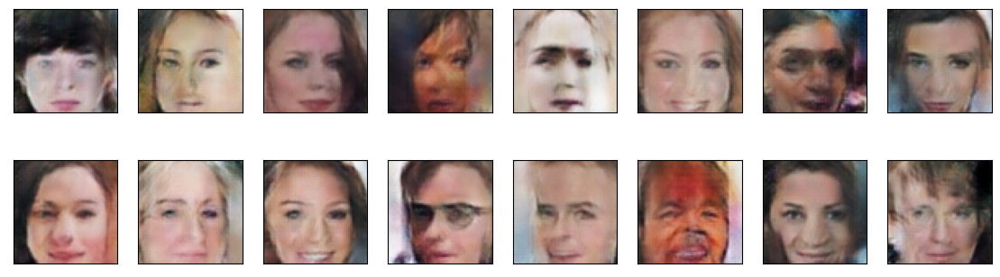

Starting Epoch [13/50]...
2024-11-01 14:32:38 | Epoch [13/50] | Batch 0/509 | d_loss: 0.0300 | g_loss: 6.7097
2024-11-01 14:32:47 | Epoch [13/50] | Batch 50/509 | d_loss: 0.0074 | g_loss: 7.6659
2024-11-01 14:32:55 | Epoch [13/50] | Batch 100/509 | d_loss: 0.0296 | g_loss: 8.5045
2024-11-01 14:33:03 | Epoch [13/50] | Batch 150/509 | d_loss: 0.0439 | g_loss: 6.4016
2024-11-01 14:33:11 | Epoch [13/50] | Batch 200/509 | d_loss: 0.1420 | g_loss: 8.0463
2024-11-01 14:33:19 | Epoch [13/50] | Batch 250/509 | d_loss: 0.0881 | g_loss: 4.5597
2024-11-01 14:33:27 | Epoch [13/50] | Batch 300/509 | d_loss: 0.0441 | g_loss: 5.4256
2024-11-01 14:33:35 | Epoch [13/50] | Batch 350/509 | d_loss: 0.1362 | g_loss: 2.3345
2024-11-01 14:33:43 | Epoch [13/50] | Batch 400/509 | d_loss: 0.0220 | g_loss: 5.1205
2024-11-01 14:33:51 | Epoch [13/50] | Batch 450/509 | d_loss: 0.0685 | g_loss: 3.4108
2024-11-01 14:33:59 | Epoch [13/50] | Batch 500/509 | d_loss: 0.3300 | g_loss: 4.1170
End of Epoch [13/50]. Generatin

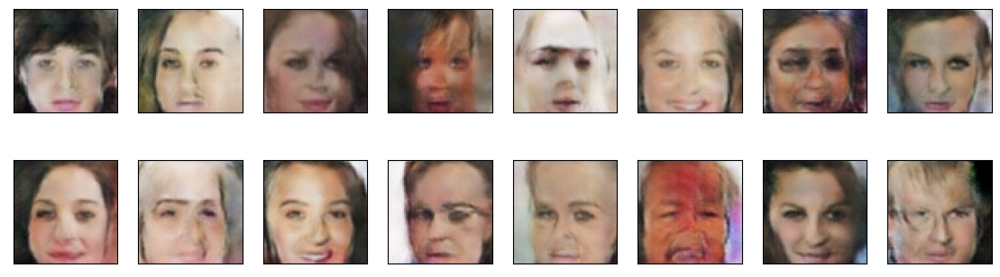

Starting Epoch [14/50]...
2024-11-01 14:34:01 | Epoch [14/50] | Batch 0/509 | d_loss: 0.1461 | g_loss: 5.0828
2024-11-01 14:34:09 | Epoch [14/50] | Batch 50/509 | d_loss: 0.1307 | g_loss: 6.7846
2024-11-01 14:34:17 | Epoch [14/50] | Batch 100/509 | d_loss: 0.0790 | g_loss: 4.8666
2024-11-01 14:34:25 | Epoch [14/50] | Batch 150/509 | d_loss: 1.2097 | g_loss: 8.5904
2024-11-01 14:34:33 | Epoch [14/50] | Batch 200/509 | d_loss: 0.0230 | g_loss: 5.6839
2024-11-01 14:34:41 | Epoch [14/50] | Batch 250/509 | d_loss: 0.0602 | g_loss: 4.9715
2024-11-01 14:34:49 | Epoch [14/50] | Batch 300/509 | d_loss: 0.0639 | g_loss: 6.0940
2024-11-01 14:34:57 | Epoch [14/50] | Batch 350/509 | d_loss: 0.1482 | g_loss: 9.7227
2024-11-01 14:35:05 | Epoch [14/50] | Batch 400/509 | d_loss: 0.4697 | g_loss: 10.6623
2024-11-01 14:35:13 | Epoch [14/50] | Batch 450/509 | d_loss: 0.0743 | g_loss: 3.5060
2024-11-01 14:35:21 | Epoch [14/50] | Batch 500/509 | d_loss: 0.0292 | g_loss: 4.3196
End of Epoch [14/50]. Generati

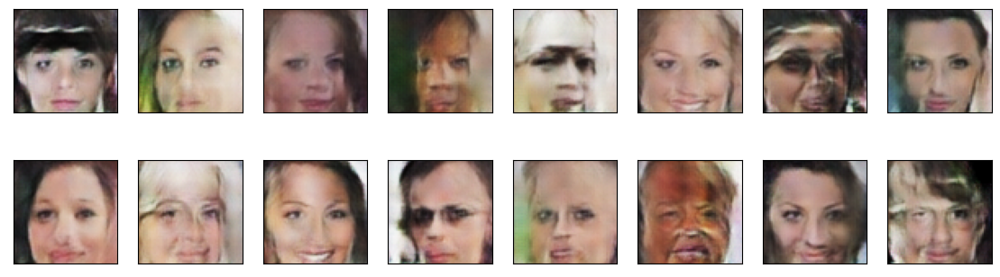

Starting Epoch [15/50]...
2024-11-01 14:35:23 | Epoch [15/50] | Batch 0/509 | d_loss: 0.0064 | g_loss: 8.0729
2024-11-01 14:35:31 | Epoch [15/50] | Batch 50/509 | d_loss: 0.0116 | g_loss: 11.5159
2024-11-01 14:35:39 | Epoch [15/50] | Batch 100/509 | d_loss: 0.0246 | g_loss: 4.5277
2024-11-01 14:35:47 | Epoch [15/50] | Batch 150/509 | d_loss: 0.1199 | g_loss: 9.1895
2024-11-01 14:35:55 | Epoch [15/50] | Batch 200/509 | d_loss: 0.2490 | g_loss: 6.3414
2024-11-01 14:36:03 | Epoch [15/50] | Batch 250/509 | d_loss: 0.0921 | g_loss: 4.6179
2024-11-01 14:36:11 | Epoch [15/50] | Batch 300/509 | d_loss: 0.0487 | g_loss: 4.8774
2024-11-01 14:36:19 | Epoch [15/50] | Batch 350/509 | d_loss: 0.0124 | g_loss: 5.9267
2024-11-01 14:36:27 | Epoch [15/50] | Batch 400/509 | d_loss: 0.0579 | g_loss: 6.3621
2024-11-01 14:36:34 | Epoch [15/50] | Batch 450/509 | d_loss: 0.5309 | g_loss: 6.2513
2024-11-01 14:36:42 | Epoch [15/50] | Batch 500/509 | d_loss: 0.0443 | g_loss: 5.7153
End of Epoch [15/50]. Generati

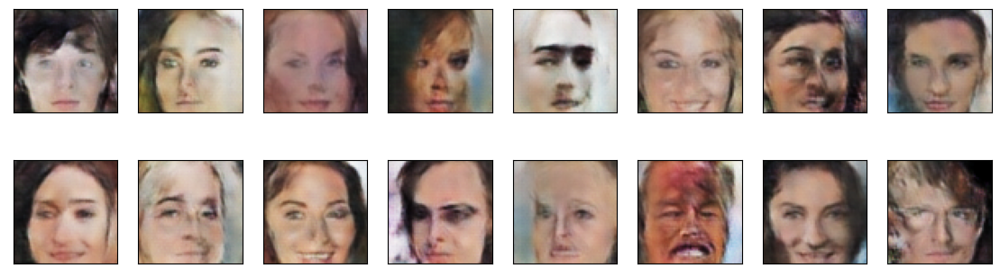

Starting Epoch [16/50]...
2024-11-01 14:36:44 | Epoch [16/50] | Batch 0/509 | d_loss: 0.2267 | g_loss: 5.7651
2024-11-01 14:36:52 | Epoch [16/50] | Batch 50/509 | d_loss: 0.0480 | g_loss: 5.5936
2024-11-01 14:37:00 | Epoch [16/50] | Batch 100/509 | d_loss: 0.0310 | g_loss: 7.0334
2024-11-01 14:37:08 | Epoch [16/50] | Batch 150/509 | d_loss: 0.1470 | g_loss: 4.3299
2024-11-01 14:37:16 | Epoch [16/50] | Batch 200/509 | d_loss: 0.1742 | g_loss: 3.6106
2024-11-01 14:37:24 | Epoch [16/50] | Batch 250/509 | d_loss: 0.3026 | g_loss: 6.1221
2024-11-01 14:37:32 | Epoch [16/50] | Batch 300/509 | d_loss: 0.0288 | g_loss: 4.7269
2024-11-01 14:37:39 | Epoch [16/50] | Batch 350/509 | d_loss: 0.0303 | g_loss: 5.2826
2024-11-01 14:37:48 | Epoch [16/50] | Batch 400/509 | d_loss: 0.0903 | g_loss: 7.6781
2024-11-01 14:37:55 | Epoch [16/50] | Batch 450/509 | d_loss: 0.0036 | g_loss: 7.7797
2024-11-01 14:38:03 | Epoch [16/50] | Batch 500/509 | d_loss: 0.0044 | g_loss: 6.0973
End of Epoch [16/50]. Generatin

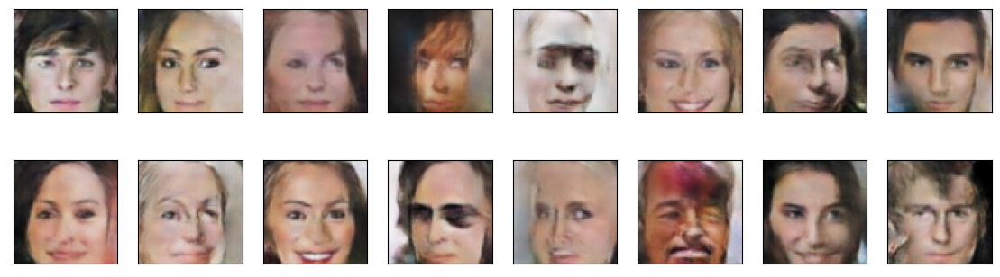

Starting Epoch [17/50]...
2024-11-01 14:38:05 | Epoch [17/50] | Batch 0/509 | d_loss: 0.0408 | g_loss: 6.8266
2024-11-01 14:38:13 | Epoch [17/50] | Batch 50/509 | d_loss: 0.0276 | g_loss: 7.9576
2024-11-01 14:38:21 | Epoch [17/50] | Batch 100/509 | d_loss: 0.0118 | g_loss: 8.5450
2024-11-01 14:38:29 | Epoch [17/50] | Batch 150/509 | d_loss: 0.0359 | g_loss: 7.2158
2024-11-01 14:38:37 | Epoch [17/50] | Batch 200/509 | d_loss: 0.5115 | g_loss: 3.9325
2024-11-01 14:38:45 | Epoch [17/50] | Batch 250/509 | d_loss: 0.0428 | g_loss: 5.5660
2024-11-01 14:38:53 | Epoch [17/50] | Batch 300/509 | d_loss: 0.7415 | g_loss: 7.1715
2024-11-01 14:39:01 | Epoch [17/50] | Batch 350/509 | d_loss: 0.2946 | g_loss: 4.5832
2024-11-01 14:39:09 | Epoch [17/50] | Batch 400/509 | d_loss: 0.0319 | g_loss: 5.3602
2024-11-01 14:39:17 | Epoch [17/50] | Batch 450/509 | d_loss: 0.1616 | g_loss: 4.0585
2024-11-01 14:39:24 | Epoch [17/50] | Batch 500/509 | d_loss: 0.0213 | g_loss: 7.0725
End of Epoch [17/50]. Generatin

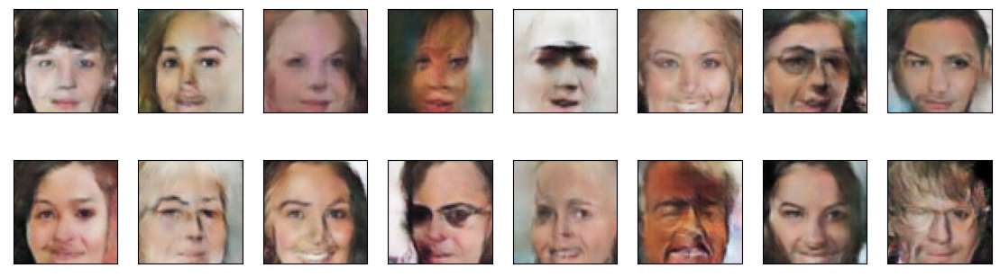

Starting Epoch [18/50]...
2024-11-01 14:39:26 | Epoch [18/50] | Batch 0/509 | d_loss: 0.0893 | g_loss: 5.1021
2024-11-01 14:39:34 | Epoch [18/50] | Batch 50/509 | d_loss: 0.0318 | g_loss: 5.0532
2024-11-01 14:39:42 | Epoch [18/50] | Batch 100/509 | d_loss: 0.1100 | g_loss: 4.4604
2024-11-01 14:39:50 | Epoch [18/50] | Batch 150/509 | d_loss: 0.8578 | g_loss: 10.6726
2024-11-01 14:39:58 | Epoch [18/50] | Batch 200/509 | d_loss: 0.0114 | g_loss: 9.0364
2024-11-01 14:40:06 | Epoch [18/50] | Batch 250/509 | d_loss: 0.0091 | g_loss: 8.1191
2024-11-01 14:40:14 | Epoch [18/50] | Batch 300/509 | d_loss: 0.2246 | g_loss: 4.2520
2024-11-01 14:40:22 | Epoch [18/50] | Batch 350/509 | d_loss: 0.0249 | g_loss: 4.9345
2024-11-01 14:40:29 | Epoch [18/50] | Batch 400/509 | d_loss: 0.1123 | g_loss: 4.7499
2024-11-01 14:40:37 | Epoch [18/50] | Batch 450/509 | d_loss: 0.0094 | g_loss: 8.9463
2024-11-01 14:40:45 | Epoch [18/50] | Batch 500/509 | d_loss: 0.0417 | g_loss: 5.0948
End of Epoch [18/50]. Generati

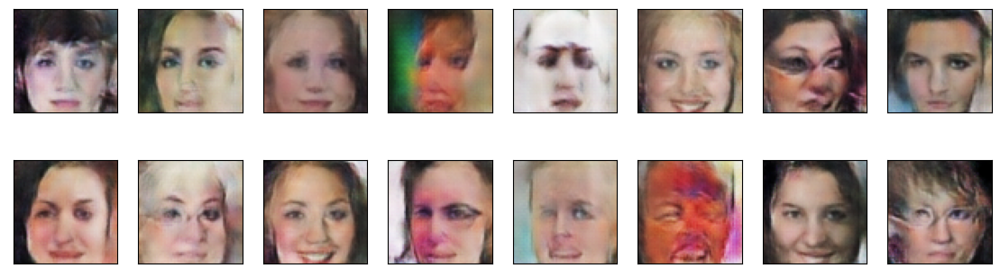

Starting Epoch [19/50]...
2024-11-01 14:40:47 | Epoch [19/50] | Batch 0/509 | d_loss: 0.1258 | g_loss: 4.6473
2024-11-01 14:40:55 | Epoch [19/50] | Batch 50/509 | d_loss: 0.0059 | g_loss: 6.7796
2024-11-01 14:41:03 | Epoch [19/50] | Batch 100/509 | d_loss: 0.1035 | g_loss: 4.4477
2024-11-01 14:41:11 | Epoch [19/50] | Batch 150/509 | d_loss: 0.2968 | g_loss: 7.3138
2024-11-01 14:41:19 | Epoch [19/50] | Batch 200/509 | d_loss: 0.0065 | g_loss: 6.8644
2024-11-01 14:41:27 | Epoch [19/50] | Batch 250/509 | d_loss: 0.1270 | g_loss: 4.6469
2024-11-01 14:41:35 | Epoch [19/50] | Batch 300/509 | d_loss: 0.1342 | g_loss: 5.5471
2024-11-01 14:41:43 | Epoch [19/50] | Batch 350/509 | d_loss: 0.0440 | g_loss: 6.8432
2024-11-01 14:41:51 | Epoch [19/50] | Batch 400/509 | d_loss: 0.4387 | g_loss: 9.9570
2024-11-01 14:41:59 | Epoch [19/50] | Batch 450/509 | d_loss: 0.0228 | g_loss: 4.8503
2024-11-01 14:42:07 | Epoch [19/50] | Batch 500/509 | d_loss: 0.0254 | g_loss: 4.8384
End of Epoch [19/50]. Generatin

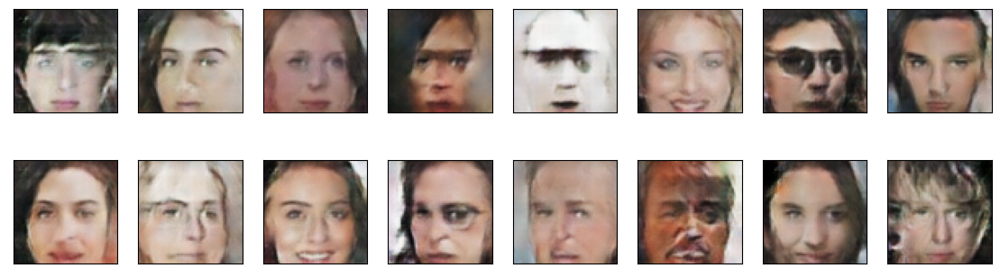

Starting Epoch [20/50]...
2024-11-01 14:42:09 | Epoch [20/50] | Batch 0/509 | d_loss: 0.0653 | g_loss: 5.6284
2024-11-01 14:42:17 | Epoch [20/50] | Batch 50/509 | d_loss: 0.5676 | g_loss: 5.4366
2024-11-01 14:42:25 | Epoch [20/50] | Batch 100/509 | d_loss: 0.0473 | g_loss: 4.5820
2024-11-01 14:42:33 | Epoch [20/50] | Batch 150/509 | d_loss: 0.0232 | g_loss: 3.7944
2024-11-01 14:42:41 | Epoch [20/50] | Batch 200/509 | d_loss: 0.0468 | g_loss: 4.1658
2024-11-01 14:42:49 | Epoch [20/50] | Batch 250/509 | d_loss: 0.1332 | g_loss: 3.7339
2024-11-01 14:42:57 | Epoch [20/50] | Batch 300/509 | d_loss: 0.1263 | g_loss: 3.9607
2024-11-01 14:43:04 | Epoch [20/50] | Batch 350/509 | d_loss: 0.1764 | g_loss: 5.2907
2024-11-01 14:43:12 | Epoch [20/50] | Batch 400/509 | d_loss: 0.0137 | g_loss: 6.5058
2024-11-01 14:43:20 | Epoch [20/50] | Batch 450/509 | d_loss: 0.2415 | g_loss: 7.2545
2024-11-01 14:43:28 | Epoch [20/50] | Batch 500/509 | d_loss: 0.0227 | g_loss: 5.1051
End of Epoch [20/50]. Generatin

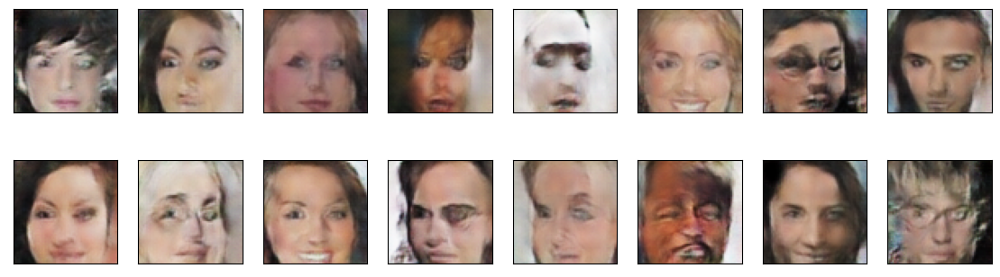

Starting Epoch [21/50]...
2024-11-01 14:43:30 | Epoch [21/50] | Batch 0/509 | d_loss: 0.1168 | g_loss: 4.8637
2024-11-01 14:43:38 | Epoch [21/50] | Batch 50/509 | d_loss: 0.4293 | g_loss: 6.0745
2024-11-01 14:43:46 | Epoch [21/50] | Batch 100/509 | d_loss: 0.0624 | g_loss: 3.6163
2024-11-01 14:43:54 | Epoch [21/50] | Batch 150/509 | d_loss: 0.0858 | g_loss: 4.5396
2024-11-01 14:44:02 | Epoch [21/50] | Batch 200/509 | d_loss: 0.0429 | g_loss: 4.9395
2024-11-01 14:44:10 | Epoch [21/50] | Batch 250/509 | d_loss: 0.3321 | g_loss: 5.7837
2024-11-01 14:44:18 | Epoch [21/50] | Batch 300/509 | d_loss: 0.0223 | g_loss: 3.9476
2024-11-01 14:44:26 | Epoch [21/50] | Batch 350/509 | d_loss: 0.7794 | g_loss: 9.7984
2024-11-01 14:44:33 | Epoch [21/50] | Batch 400/509 | d_loss: 0.0885 | g_loss: 4.6099
2024-11-01 14:44:41 | Epoch [21/50] | Batch 450/509 | d_loss: 0.1226 | g_loss: 6.2616
2024-11-01 14:44:49 | Epoch [21/50] | Batch 500/509 | d_loss: 0.1267 | g_loss: 6.5797
End of Epoch [21/50]. Generatin

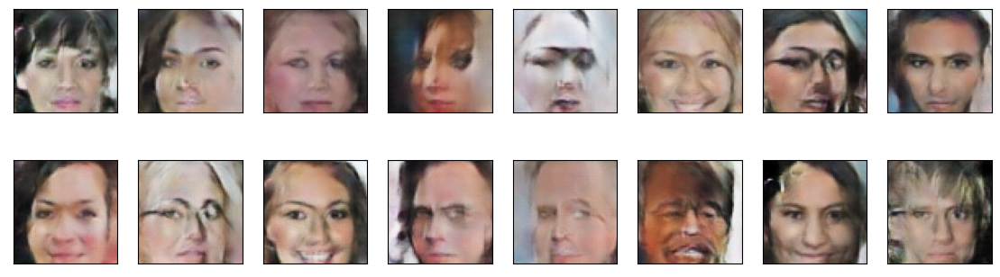

Starting Epoch [22/50]...
2024-11-01 14:44:51 | Epoch [22/50] | Batch 0/509 | d_loss: 4.5186 | g_loss: 5.5719
2024-11-01 14:44:59 | Epoch [22/50] | Batch 50/509 | d_loss: 0.0648 | g_loss: 6.2691
2024-11-01 14:45:07 | Epoch [22/50] | Batch 100/509 | d_loss: 0.4906 | g_loss: 5.7215
2024-11-01 14:45:14 | Epoch [22/50] | Batch 150/509 | d_loss: 0.0464 | g_loss: 4.6685
2024-11-01 14:45:22 | Epoch [22/50] | Batch 200/509 | d_loss: 0.2668 | g_loss: 7.5637
2024-11-01 14:45:30 | Epoch [22/50] | Batch 250/509 | d_loss: 0.2437 | g_loss: 4.4098
2024-11-01 14:45:38 | Epoch [22/50] | Batch 300/509 | d_loss: 0.1351 | g_loss: 5.2098
2024-11-01 14:45:46 | Epoch [22/50] | Batch 350/509 | d_loss: 0.0752 | g_loss: 6.0121
2024-11-01 14:45:53 | Epoch [22/50] | Batch 400/509 | d_loss: 0.0501 | g_loss: 4.9211
2024-11-01 14:46:01 | Epoch [22/50] | Batch 450/509 | d_loss: 0.0446 | g_loss: 3.7775
2024-11-01 14:46:09 | Epoch [22/50] | Batch 500/509 | d_loss: 0.1192 | g_loss: 5.3531
End of Epoch [22/50]. Generatin

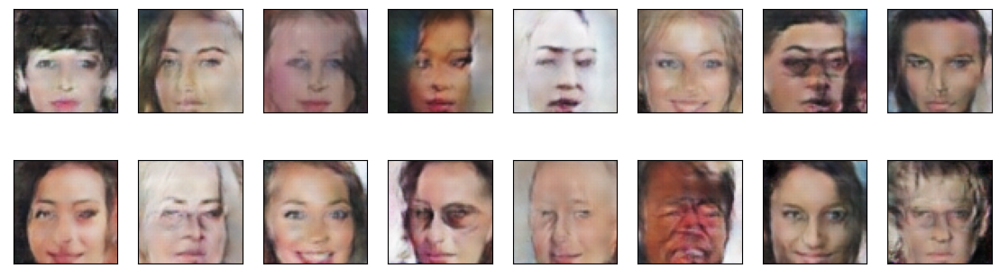

Starting Epoch [23/50]...
2024-11-01 14:46:11 | Epoch [23/50] | Batch 0/509 | d_loss: 0.2248 | g_loss: 4.7963
2024-11-01 14:46:19 | Epoch [23/50] | Batch 50/509 | d_loss: 0.0652 | g_loss: 4.5075
2024-11-01 14:46:27 | Epoch [23/50] | Batch 100/509 | d_loss: 0.2677 | g_loss: 2.0595
2024-11-01 14:46:35 | Epoch [23/50] | Batch 150/509 | d_loss: 0.7186 | g_loss: 8.1192
2024-11-01 14:46:42 | Epoch [23/50] | Batch 200/509 | d_loss: 0.0205 | g_loss: 5.7379
2024-11-01 14:46:50 | Epoch [23/50] | Batch 250/509 | d_loss: 0.2275 | g_loss: 4.9219
2024-11-01 14:46:58 | Epoch [23/50] | Batch 300/509 | d_loss: 0.0034 | g_loss: 7.2478
2024-11-01 14:47:06 | Epoch [23/50] | Batch 350/509 | d_loss: 0.0061 | g_loss: 6.1530
2024-11-01 14:47:14 | Epoch [23/50] | Batch 400/509 | d_loss: 0.1153 | g_loss: 5.4140
2024-11-01 14:47:22 | Epoch [23/50] | Batch 450/509 | d_loss: 0.0097 | g_loss: 6.2369
2024-11-01 14:47:30 | Epoch [23/50] | Batch 500/509 | d_loss: 0.0117 | g_loss: 5.9219
End of Epoch [23/50]. Generatin

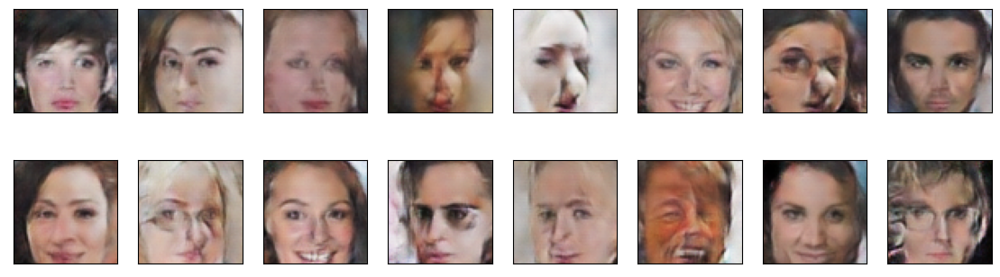

Starting Epoch [24/50]...
2024-11-01 14:47:32 | Epoch [24/50] | Batch 0/509 | d_loss: 0.0591 | g_loss: 12.0591
2024-11-01 14:47:40 | Epoch [24/50] | Batch 50/509 | d_loss: 0.2210 | g_loss: 5.0162
2024-11-01 14:47:48 | Epoch [24/50] | Batch 100/509 | d_loss: 0.9917 | g_loss: 7.1136
2024-11-01 14:47:55 | Epoch [24/50] | Batch 150/509 | d_loss: 0.1222 | g_loss: 4.6510
2024-11-01 14:48:03 | Epoch [24/50] | Batch 200/509 | d_loss: 0.1138 | g_loss: 5.7605
2024-11-01 14:48:11 | Epoch [24/50] | Batch 250/509 | d_loss: 0.0097 | g_loss: 6.2901
2024-11-01 14:48:19 | Epoch [24/50] | Batch 300/509 | d_loss: 0.0046 | g_loss: 6.1200
2024-11-01 14:48:27 | Epoch [24/50] | Batch 350/509 | d_loss: 0.0236 | g_loss: 4.8827
2024-11-01 14:48:35 | Epoch [24/50] | Batch 400/509 | d_loss: 0.4472 | g_loss: 3.5691
2024-11-01 14:48:43 | Epoch [24/50] | Batch 450/509 | d_loss: 0.0318 | g_loss: 4.9615
2024-11-01 14:48:51 | Epoch [24/50] | Batch 500/509 | d_loss: 4.7925 | g_loss: 5.7430
End of Epoch [24/50]. Generati

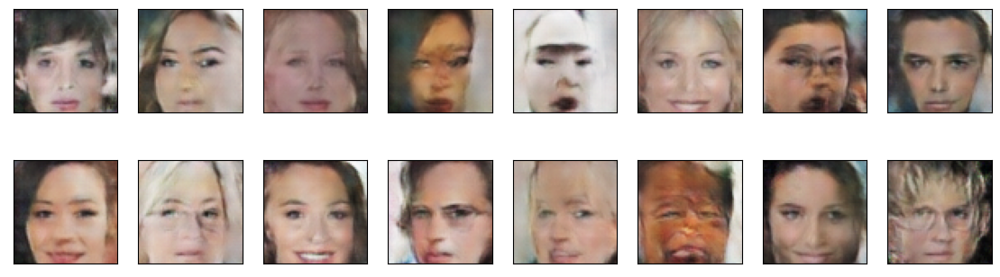

Starting Epoch [25/50]...
2024-11-01 14:48:53 | Epoch [25/50] | Batch 0/509 | d_loss: 0.5066 | g_loss: 5.6280
2024-11-01 14:49:00 | Epoch [25/50] | Batch 50/509 | d_loss: 0.0051 | g_loss: 7.1618
2024-11-01 14:49:08 | Epoch [25/50] | Batch 100/509 | d_loss: 0.0025 | g_loss: 10.4987
2024-11-01 14:49:16 | Epoch [25/50] | Batch 150/509 | d_loss: 0.1960 | g_loss: 5.6109
2024-11-01 14:49:24 | Epoch [25/50] | Batch 200/509 | d_loss: 0.9005 | g_loss: 10.4781
2024-11-01 14:49:32 | Epoch [25/50] | Batch 250/509 | d_loss: 0.0178 | g_loss: 6.9424
2024-11-01 14:49:40 | Epoch [25/50] | Batch 300/509 | d_loss: 0.1142 | g_loss: 7.6453
2024-11-01 14:49:48 | Epoch [25/50] | Batch 350/509 | d_loss: 0.0038 | g_loss: 8.8468
2024-11-01 14:49:56 | Epoch [25/50] | Batch 400/509 | d_loss: 1.6255 | g_loss: 2.3371
2024-11-01 14:50:04 | Epoch [25/50] | Batch 450/509 | d_loss: 0.0164 | g_loss: 6.0420
2024-11-01 14:50:12 | Epoch [25/50] | Batch 500/509 | d_loss: 0.0577 | g_loss: 4.7515
End of Epoch [25/50]. Generat

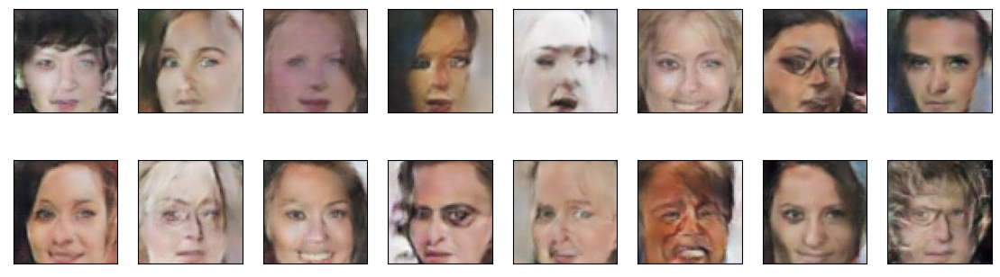

Starting Epoch [26/50]...
2024-11-01 14:50:14 | Epoch [26/50] | Batch 0/509 | d_loss: 0.0176 | g_loss: 6.6582
2024-11-01 14:50:22 | Epoch [26/50] | Batch 50/509 | d_loss: 0.1046 | g_loss: 4.1870
2024-11-01 14:50:29 | Epoch [26/50] | Batch 100/509 | d_loss: 0.0083 | g_loss: 6.2542
2024-11-01 14:50:37 | Epoch [26/50] | Batch 150/509 | d_loss: 0.0063 | g_loss: 5.3272
2024-11-01 14:50:45 | Epoch [26/50] | Batch 200/509 | d_loss: 0.0604 | g_loss: 3.9128
2024-11-01 14:50:53 | Epoch [26/50] | Batch 250/509 | d_loss: 0.0410 | g_loss: 5.2690
2024-11-01 14:51:01 | Epoch [26/50] | Batch 300/509 | d_loss: 0.0761 | g_loss: 4.7457
2024-11-01 14:51:09 | Epoch [26/50] | Batch 350/509 | d_loss: 0.0255 | g_loss: 5.2812
2024-11-01 14:51:17 | Epoch [26/50] | Batch 400/509 | d_loss: 0.0128 | g_loss: 5.6578
2024-11-01 14:51:25 | Epoch [26/50] | Batch 450/509 | d_loss: 0.1973 | g_loss: 4.7783
2024-11-01 14:51:33 | Epoch [26/50] | Batch 500/509 | d_loss: 0.0469 | g_loss: 4.7932
End of Epoch [26/50]. Generatin

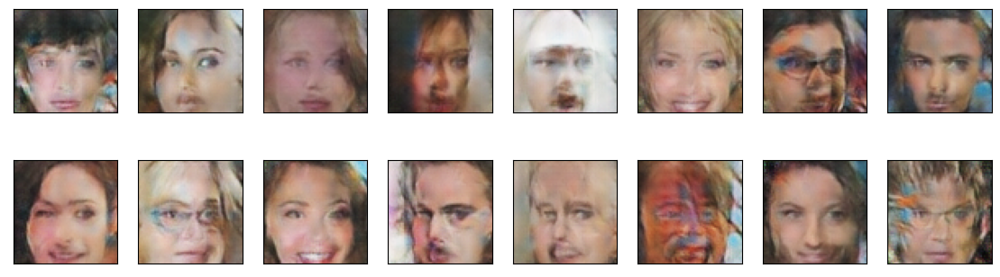

Starting Epoch [27/50]...
2024-11-01 14:51:35 | Epoch [27/50] | Batch 0/509 | d_loss: 0.3138 | g_loss: 4.1400
2024-11-01 14:51:43 | Epoch [27/50] | Batch 50/509 | d_loss: 0.1178 | g_loss: 4.7448
2024-11-01 14:51:51 | Epoch [27/50] | Batch 100/509 | d_loss: 0.0271 | g_loss: 7.7397
2024-11-01 14:51:59 | Epoch [27/50] | Batch 150/509 | d_loss: 0.0630 | g_loss: 2.8428
2024-11-01 14:52:06 | Epoch [27/50] | Batch 200/509 | d_loss: 0.0708 | g_loss: 4.2851
2024-11-01 14:52:14 | Epoch [27/50] | Batch 250/509 | d_loss: 0.0174 | g_loss: 5.0436
2024-11-01 14:52:22 | Epoch [27/50] | Batch 300/509 | d_loss: 0.2979 | g_loss: 8.5176
2024-11-01 14:52:30 | Epoch [27/50] | Batch 350/509 | d_loss: 0.0021 | g_loss: 6.9781
2024-11-01 14:52:38 | Epoch [27/50] | Batch 400/509 | d_loss: 0.3138 | g_loss: 3.6082
2024-11-01 14:52:46 | Epoch [27/50] | Batch 450/509 | d_loss: 0.0130 | g_loss: 5.5219
2024-11-01 14:52:54 | Epoch [27/50] | Batch 500/509 | d_loss: 0.7088 | g_loss: 5.9030
End of Epoch [27/50]. Generatin

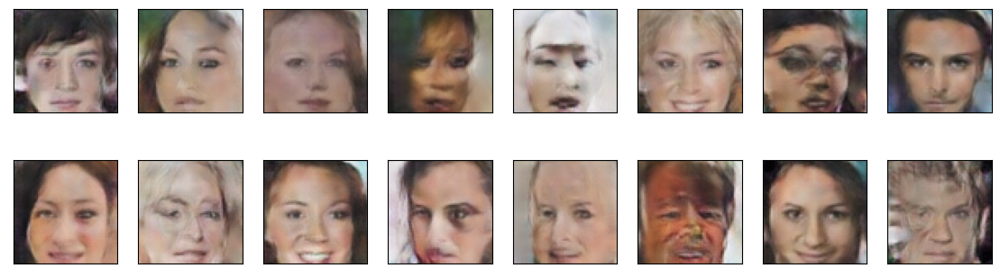

Starting Epoch [28/50]...
2024-11-01 14:52:56 | Epoch [28/50] | Batch 0/509 | d_loss: 0.3076 | g_loss: 2.9743
2024-11-01 14:53:03 | Epoch [28/50] | Batch 50/509 | d_loss: 0.2727 | g_loss: 5.4682
2024-11-01 14:53:11 | Epoch [28/50] | Batch 100/509 | d_loss: 0.1912 | g_loss: 3.9753
2024-11-01 14:53:19 | Epoch [28/50] | Batch 150/509 | d_loss: 0.0928 | g_loss: 4.4783
2024-11-01 14:53:27 | Epoch [28/50] | Batch 200/509 | d_loss: 1.1081 | g_loss: 9.7023
2024-11-01 14:53:35 | Epoch [28/50] | Batch 250/509 | d_loss: 0.1324 | g_loss: 8.2879
2024-11-01 14:53:43 | Epoch [28/50] | Batch 300/509 | d_loss: 0.0399 | g_loss: 4.6057
2024-11-01 14:53:51 | Epoch [28/50] | Batch 350/509 | d_loss: 0.1209 | g_loss: 4.1447
2024-11-01 14:53:59 | Epoch [28/50] | Batch 400/509 | d_loss: 0.0025 | g_loss: 8.2707
2024-11-01 14:54:07 | Epoch [28/50] | Batch 450/509 | d_loss: 1.2492 | g_loss: 2.1755
2024-11-01 14:54:15 | Epoch [28/50] | Batch 500/509 | d_loss: 0.6820 | g_loss: 5.5134
End of Epoch [28/50]. Generatin

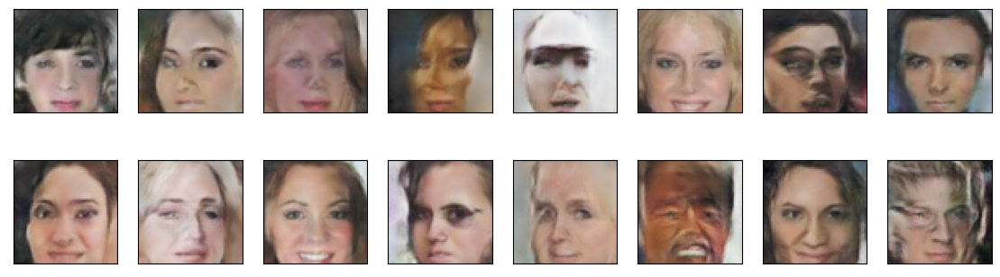

Starting Epoch [29/50]...
2024-11-01 14:54:16 | Epoch [29/50] | Batch 0/509 | d_loss: 0.0319 | g_loss: 4.7631
2024-11-01 14:54:24 | Epoch [29/50] | Batch 50/509 | d_loss: 0.0992 | g_loss: 5.1090
2024-11-01 14:54:32 | Epoch [29/50] | Batch 100/509 | d_loss: 0.2540 | g_loss: 5.8210
2024-11-01 14:54:40 | Epoch [29/50] | Batch 150/509 | d_loss: 0.0096 | g_loss: 5.0315
2024-11-01 14:54:47 | Epoch [29/50] | Batch 200/509 | d_loss: 0.3410 | g_loss: 2.3659
2024-11-01 14:54:55 | Epoch [29/50] | Batch 250/509 | d_loss: 0.2265 | g_loss: 4.5675
2024-11-01 14:55:03 | Epoch [29/50] | Batch 300/509 | d_loss: 0.0794 | g_loss: 4.0857
2024-11-01 14:55:11 | Epoch [29/50] | Batch 350/509 | d_loss: 0.1921 | g_loss: 4.1843
2024-11-01 14:55:18 | Epoch [29/50] | Batch 400/509 | d_loss: 0.1682 | g_loss: 3.6989
2024-11-01 14:55:26 | Epoch [29/50] | Batch 450/509 | d_loss: 0.0254 | g_loss: 5.7621
2024-11-01 14:55:34 | Epoch [29/50] | Batch 500/509 | d_loss: 0.1565 | g_loss: 4.7647
End of Epoch [29/50]. Generatin

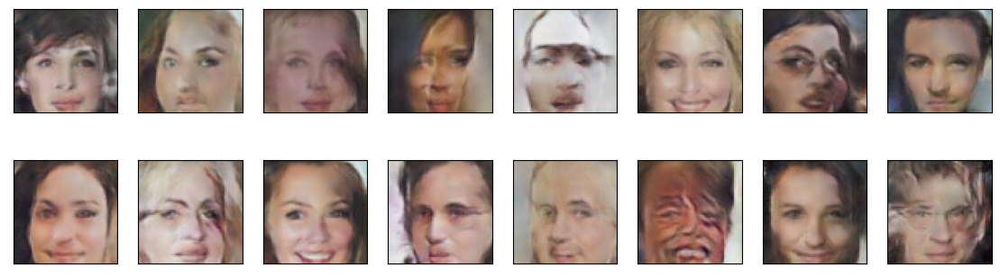

Starting Epoch [30/50]...
2024-11-01 14:55:36 | Epoch [30/50] | Batch 0/509 | d_loss: 0.0138 | g_loss: 4.6237
2024-11-01 14:55:43 | Epoch [30/50] | Batch 50/509 | d_loss: 0.3068 | g_loss: 6.4947
2024-11-01 14:55:51 | Epoch [30/50] | Batch 100/509 | d_loss: 0.7234 | g_loss: 6.8859
2024-11-01 14:55:59 | Epoch [30/50] | Batch 150/509 | d_loss: 0.0112 | g_loss: 6.1025
2024-11-01 14:56:07 | Epoch [30/50] | Batch 200/509 | d_loss: 0.0104 | g_loss: 6.5261
2024-11-01 14:56:15 | Epoch [30/50] | Batch 250/509 | d_loss: 0.0388 | g_loss: 4.0413
2024-11-01 14:56:22 | Epoch [30/50] | Batch 300/509 | d_loss: 0.0045 | g_loss: 5.9626
2024-11-01 14:56:30 | Epoch [30/50] | Batch 350/509 | d_loss: 0.0055 | g_loss: 6.9808
2024-11-01 14:56:38 | Epoch [30/50] | Batch 400/509 | d_loss: 0.0417 | g_loss: 5.0228
2024-11-01 14:56:46 | Epoch [30/50] | Batch 450/509 | d_loss: 0.4406 | g_loss: 5.7729
2024-11-01 14:56:54 | Epoch [30/50] | Batch 500/509 | d_loss: 0.0341 | g_loss: 6.9983
End of Epoch [30/50]. Generatin

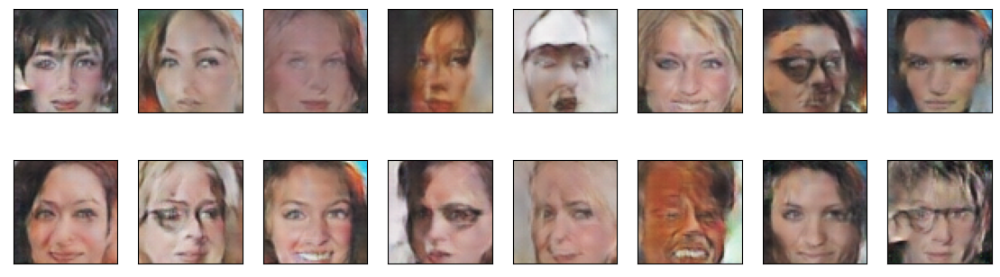

Starting Epoch [31/50]...
2024-11-01 14:56:55 | Epoch [31/50] | Batch 0/509 | d_loss: 0.0035 | g_loss: 7.4230
2024-11-01 14:57:03 | Epoch [31/50] | Batch 50/509 | d_loss: 0.0091 | g_loss: 6.9494
2024-11-01 14:57:11 | Epoch [31/50] | Batch 100/509 | d_loss: 0.0200 | g_loss: 6.4342
2024-11-01 14:57:19 | Epoch [31/50] | Batch 150/509 | d_loss: 0.0371 | g_loss: 5.2617
2024-11-01 14:57:26 | Epoch [31/50] | Batch 200/509 | d_loss: 0.0399 | g_loss: 5.3712
2024-11-01 14:57:34 | Epoch [31/50] | Batch 250/509 | d_loss: 0.0212 | g_loss: 5.8189
2024-11-01 14:57:42 | Epoch [31/50] | Batch 300/509 | d_loss: 4.8649 | g_loss: 6.9292
2024-11-01 14:57:50 | Epoch [31/50] | Batch 350/509 | d_loss: 0.0095 | g_loss: 5.9267
2024-11-01 14:57:57 | Epoch [31/50] | Batch 400/509 | d_loss: 0.0202 | g_loss: 4.3455
2024-11-01 14:58:05 | Epoch [31/50] | Batch 450/509 | d_loss: 0.0116 | g_loss: 5.6718
2024-11-01 14:58:13 | Epoch [31/50] | Batch 500/509 | d_loss: 0.0195 | g_loss: 5.9407
End of Epoch [31/50]. Generatin

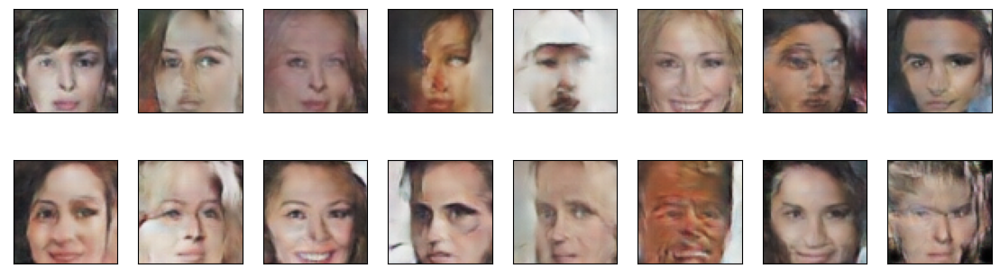

Starting Epoch [32/50]...
2024-11-01 14:58:15 | Epoch [32/50] | Batch 0/509 | d_loss: 0.0312 | g_loss: 5.4645
2024-11-01 14:58:22 | Epoch [32/50] | Batch 50/509 | d_loss: 0.2714 | g_loss: 3.8195
2024-11-01 14:58:30 | Epoch [32/50] | Batch 100/509 | d_loss: 0.0743 | g_loss: 5.1949
2024-11-01 14:58:38 | Epoch [32/50] | Batch 150/509 | d_loss: 0.1209 | g_loss: 4.8679
2024-11-01 14:58:45 | Epoch [32/50] | Batch 200/509 | d_loss: 0.0453 | g_loss: 4.8951
2024-11-01 14:58:53 | Epoch [32/50] | Batch 250/509 | d_loss: 0.0135 | g_loss: 4.8677
2024-11-01 14:59:01 | Epoch [32/50] | Batch 300/509 | d_loss: 0.0107 | g_loss: 5.0456
2024-11-01 14:59:08 | Epoch [32/50] | Batch 350/509 | d_loss: 0.1789 | g_loss: 4.9595
2024-11-01 14:59:16 | Epoch [32/50] | Batch 400/509 | d_loss: 0.2198 | g_loss: 5.4473
2024-11-01 14:59:24 | Epoch [32/50] | Batch 450/509 | d_loss: 0.0031 | g_loss: 7.1474
2024-11-01 14:59:32 | Epoch [32/50] | Batch 500/509 | d_loss: 0.4758 | g_loss: 12.6645
End of Epoch [32/50]. Generati

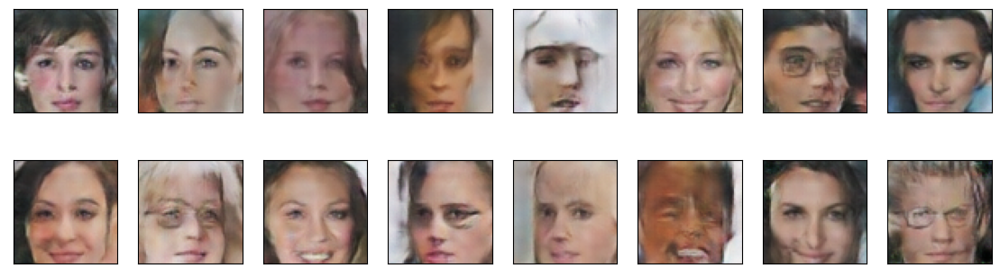

Starting Epoch [33/50]...
2024-11-01 14:59:34 | Epoch [33/50] | Batch 0/509 | d_loss: 0.5999 | g_loss: 4.6888
2024-11-01 14:59:41 | Epoch [33/50] | Batch 50/509 | d_loss: 0.0154 | g_loss: 6.2731
2024-11-01 14:59:49 | Epoch [33/50] | Batch 100/509 | d_loss: 1.0516 | g_loss: 8.9218
2024-11-01 14:59:57 | Epoch [33/50] | Batch 150/509 | d_loss: 0.2784 | g_loss: 4.6653
2024-11-01 15:00:05 | Epoch [33/50] | Batch 200/509 | d_loss: 0.1367 | g_loss: 5.1262
2024-11-01 15:00:12 | Epoch [33/50] | Batch 250/509 | d_loss: 0.1342 | g_loss: 3.9304
2024-11-01 15:00:20 | Epoch [33/50] | Batch 300/509 | d_loss: 0.0113 | g_loss: 8.1560
2024-11-01 15:00:28 | Epoch [33/50] | Batch 350/509 | d_loss: 0.0062 | g_loss: 7.9556
2024-11-01 15:00:36 | Epoch [33/50] | Batch 400/509 | d_loss: 0.0028 | g_loss: 7.3963
2024-11-01 15:00:43 | Epoch [33/50] | Batch 450/509 | d_loss: 0.0153 | g_loss: 5.5453
2024-11-01 15:00:51 | Epoch [33/50] | Batch 500/509 | d_loss: 0.5417 | g_loss: 1.9995
End of Epoch [33/50]. Generatin

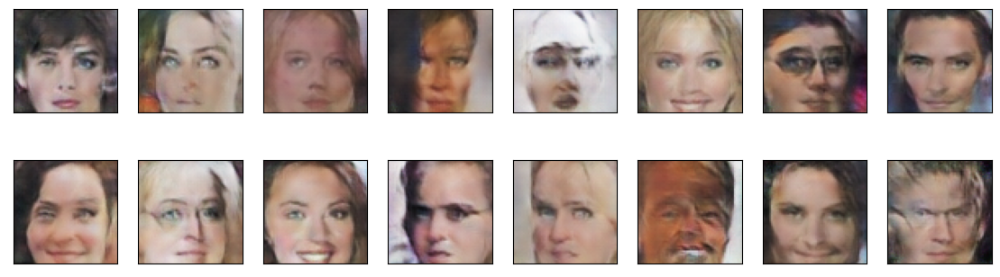

Starting Epoch [34/50]...
2024-11-01 15:00:53 | Epoch [34/50] | Batch 0/509 | d_loss: 0.1492 | g_loss: 5.3288
2024-11-01 15:01:01 | Epoch [34/50] | Batch 50/509 | d_loss: 0.6272 | g_loss: 9.7982
2024-11-01 15:01:09 | Epoch [34/50] | Batch 100/509 | d_loss: 0.0186 | g_loss: 8.0429
2024-11-01 15:01:16 | Epoch [34/50] | Batch 150/509 | d_loss: 0.0103 | g_loss: 4.3793
2024-11-01 15:01:24 | Epoch [34/50] | Batch 200/509 | d_loss: 0.0516 | g_loss: 6.4817
2024-11-01 15:01:32 | Epoch [34/50] | Batch 250/509 | d_loss: 0.0202 | g_loss: 5.8251
2024-11-01 15:01:40 | Epoch [34/50] | Batch 300/509 | d_loss: 0.0195 | g_loss: 8.4827
2024-11-01 15:01:48 | Epoch [34/50] | Batch 350/509 | d_loss: 0.9523 | g_loss: 4.3337
2024-11-01 15:01:55 | Epoch [34/50] | Batch 400/509 | d_loss: 0.2448 | g_loss: 7.4240
2024-11-01 15:02:03 | Epoch [34/50] | Batch 450/509 | d_loss: 0.0073 | g_loss: 6.7246
2024-11-01 15:02:11 | Epoch [34/50] | Batch 500/509 | d_loss: 0.2107 | g_loss: 4.2737
End of Epoch [34/50]. Generatin

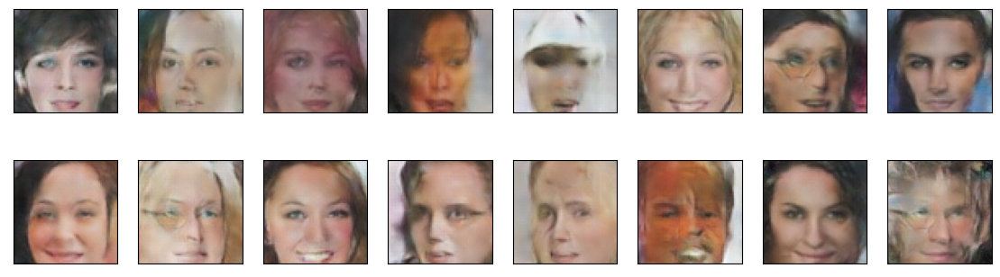

Starting Epoch [35/50]...
2024-11-01 15:02:13 | Epoch [35/50] | Batch 0/509 | d_loss: 0.0854 | g_loss: 2.9499
2024-11-01 15:02:21 | Epoch [35/50] | Batch 50/509 | d_loss: 0.0881 | g_loss: 5.7571
2024-11-01 15:02:28 | Epoch [35/50] | Batch 100/509 | d_loss: 0.0203 | g_loss: 7.2107
2024-11-01 15:02:36 | Epoch [35/50] | Batch 150/509 | d_loss: 0.0873 | g_loss: 4.5018
2024-11-01 15:02:44 | Epoch [35/50] | Batch 200/509 | d_loss: 0.0327 | g_loss: 6.5358
2024-11-01 15:02:52 | Epoch [35/50] | Batch 250/509 | d_loss: 0.1644 | g_loss: 3.7746
2024-11-01 15:02:59 | Epoch [35/50] | Batch 300/509 | d_loss: 0.0871 | g_loss: 4.3759
2024-11-01 15:03:07 | Epoch [35/50] | Batch 350/509 | d_loss: 0.1363 | g_loss: 3.5933
2024-11-01 15:03:15 | Epoch [35/50] | Batch 400/509 | d_loss: 0.0306 | g_loss: 5.5355
2024-11-01 15:03:23 | Epoch [35/50] | Batch 450/509 | d_loss: 0.0802 | g_loss: 5.2149
2024-11-01 15:03:30 | Epoch [35/50] | Batch 500/509 | d_loss: 0.4961 | g_loss: 3.8328
End of Epoch [35/50]. Generatin

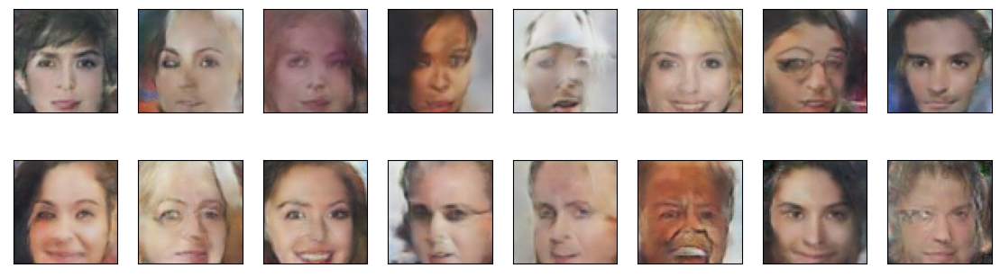

Starting Epoch [36/50]...
2024-11-01 15:03:32 | Epoch [36/50] | Batch 0/509 | d_loss: 0.1995 | g_loss: 4.5809
2024-11-01 15:03:40 | Epoch [36/50] | Batch 50/509 | d_loss: 0.6349 | g_loss: 5.9764
2024-11-01 15:03:47 | Epoch [36/50] | Batch 100/509 | d_loss: 0.0115 | g_loss: 7.4962
2024-11-01 15:03:55 | Epoch [36/50] | Batch 150/509 | d_loss: 0.0120 | g_loss: 7.3867
2024-11-01 15:04:03 | Epoch [36/50] | Batch 200/509 | d_loss: 0.5297 | g_loss: 7.1765
2024-11-01 15:04:10 | Epoch [36/50] | Batch 250/509 | d_loss: 0.1067 | g_loss: 4.3003
2024-11-01 15:04:18 | Epoch [36/50] | Batch 300/509 | d_loss: 0.0584 | g_loss: 3.4067
2024-11-01 15:04:26 | Epoch [36/50] | Batch 350/509 | d_loss: 0.2579 | g_loss: 7.4075
2024-11-01 15:04:33 | Epoch [36/50] | Batch 400/509 | d_loss: 0.2947 | g_loss: 6.1018
2024-11-01 15:04:41 | Epoch [36/50] | Batch 450/509 | d_loss: 0.0690 | g_loss: 4.9712
2024-11-01 15:04:49 | Epoch [36/50] | Batch 500/509 | d_loss: 0.0374 | g_loss: 4.3855
End of Epoch [36/50]. Generatin

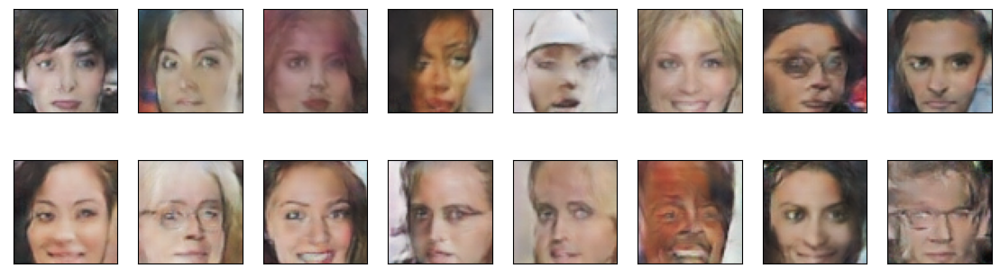

Starting Epoch [37/50]...
2024-11-01 15:04:51 | Epoch [37/50] | Batch 0/509 | d_loss: 0.0347 | g_loss: 4.7056
2024-11-01 15:04:58 | Epoch [37/50] | Batch 50/509 | d_loss: 0.0496 | g_loss: 5.1149
2024-11-01 15:05:06 | Epoch [37/50] | Batch 100/509 | d_loss: 0.0559 | g_loss: 4.5121
2024-11-01 15:05:13 | Epoch [37/50] | Batch 150/509 | d_loss: 0.0073 | g_loss: 7.9026
2024-11-01 15:05:21 | Epoch [37/50] | Batch 200/509 | d_loss: 0.0630 | g_loss: 6.3909
2024-11-01 15:05:29 | Epoch [37/50] | Batch 250/509 | d_loss: 0.0970 | g_loss: 6.2799
2024-11-01 15:05:36 | Epoch [37/50] | Batch 300/509 | d_loss: 0.0221 | g_loss: 5.0328
2024-11-01 15:05:44 | Epoch [37/50] | Batch 350/509 | d_loss: 0.0289 | g_loss: 4.7710
2024-11-01 15:05:52 | Epoch [37/50] | Batch 400/509 | d_loss: 0.0816 | g_loss: 4.8287
2024-11-01 15:05:59 | Epoch [37/50] | Batch 450/509 | d_loss: 0.0446 | g_loss: 6.1733
2024-11-01 15:06:07 | Epoch [37/50] | Batch 500/509 | d_loss: 0.0504 | g_loss: 4.3525
End of Epoch [37/50]. Generatin

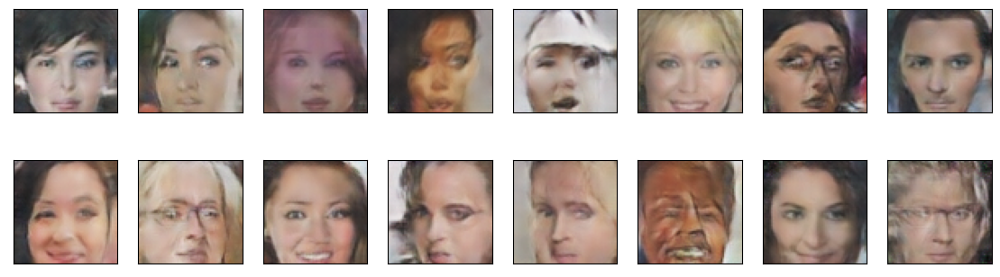

Starting Epoch [38/50]...
2024-11-01 15:06:09 | Epoch [38/50] | Batch 0/509 | d_loss: 0.0808 | g_loss: 4.0107
2024-11-01 15:06:16 | Epoch [38/50] | Batch 50/509 | d_loss: 0.3222 | g_loss: 4.6944
2024-11-01 15:06:24 | Epoch [38/50] | Batch 100/509 | d_loss: 0.0218 | g_loss: 6.4592
2024-11-01 15:06:31 | Epoch [38/50] | Batch 150/509 | d_loss: 0.0172 | g_loss: 5.4159
2024-11-01 15:06:39 | Epoch [38/50] | Batch 200/509 | d_loss: 0.0243 | g_loss: 3.2258
2024-11-01 15:06:47 | Epoch [38/50] | Batch 250/509 | d_loss: 0.1192 | g_loss: 3.8796
2024-11-01 15:06:55 | Epoch [38/50] | Batch 300/509 | d_loss: 0.0599 | g_loss: 6.3421
2024-11-01 15:07:02 | Epoch [38/50] | Batch 350/509 | d_loss: 0.0123 | g_loss: 6.7171
2024-11-01 15:07:10 | Epoch [38/50] | Batch 400/509 | d_loss: 0.0105 | g_loss: 6.4066
2024-11-01 15:07:18 | Epoch [38/50] | Batch 450/509 | d_loss: 0.3435 | g_loss: 3.7743
2024-11-01 15:07:25 | Epoch [38/50] | Batch 500/509 | d_loss: 0.1386 | g_loss: 4.2528
End of Epoch [38/50]. Generatin

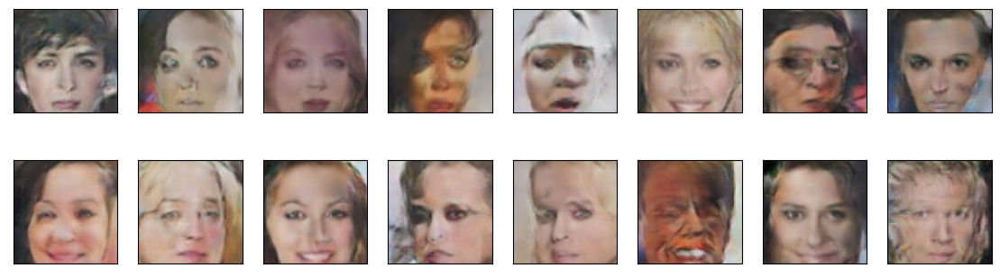

Starting Epoch [39/50]...
2024-11-01 15:07:27 | Epoch [39/50] | Batch 0/509 | d_loss: 0.0668 | g_loss: 7.1464
2024-11-01 15:07:35 | Epoch [39/50] | Batch 50/509 | d_loss: 0.0156 | g_loss: 8.9142
2024-11-01 15:07:42 | Epoch [39/50] | Batch 100/509 | d_loss: 0.2087 | g_loss: 3.9604
2024-11-01 15:07:50 | Epoch [39/50] | Batch 150/509 | d_loss: 0.7685 | g_loss: 4.8098
2024-11-01 15:07:58 | Epoch [39/50] | Batch 200/509 | d_loss: 0.1139 | g_loss: 3.2614
2024-11-01 15:08:05 | Epoch [39/50] | Batch 250/509 | d_loss: 0.1525 | g_loss: 3.9994
2024-11-01 15:08:13 | Epoch [39/50] | Batch 300/509 | d_loss: 0.1135 | g_loss: 4.7864
2024-11-01 15:08:21 | Epoch [39/50] | Batch 350/509 | d_loss: 0.0438 | g_loss: 4.1927
2024-11-01 15:08:28 | Epoch [39/50] | Batch 400/509 | d_loss: 0.0508 | g_loss: 5.1227
2024-11-01 15:08:36 | Epoch [39/50] | Batch 450/509 | d_loss: 0.0162 | g_loss: 5.9009
2024-11-01 15:08:43 | Epoch [39/50] | Batch 500/509 | d_loss: 0.0271 | g_loss: 7.7257
End of Epoch [39/50]. Generatin

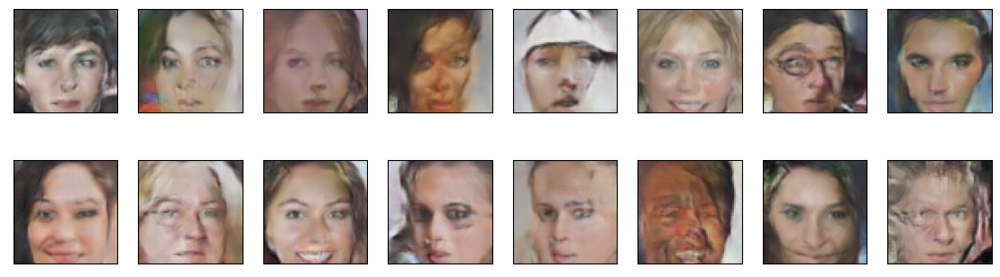

Starting Epoch [40/50]...
2024-11-01 15:08:45 | Epoch [40/50] | Batch 0/509 | d_loss: 0.0293 | g_loss: 5.1052
2024-11-01 15:08:52 | Epoch [40/50] | Batch 50/509 | d_loss: 0.2517 | g_loss: 3.2101
2024-11-01 15:09:00 | Epoch [40/50] | Batch 100/509 | d_loss: 0.1231 | g_loss: 4.7962
2024-11-01 15:09:08 | Epoch [40/50] | Batch 150/509 | d_loss: 0.0723 | g_loss: 3.7793
2024-11-01 15:09:15 | Epoch [40/50] | Batch 200/509 | d_loss: 0.1127 | g_loss: 7.1527
2024-11-01 15:09:23 | Epoch [40/50] | Batch 250/509 | d_loss: 0.2585 | g_loss: 5.2194
2024-11-01 15:09:30 | Epoch [40/50] | Batch 300/509 | d_loss: 0.3101 | g_loss: 5.8310
2024-11-01 15:09:38 | Epoch [40/50] | Batch 350/509 | d_loss: 0.0029 | g_loss: 6.4437
2024-11-01 15:09:45 | Epoch [40/50] | Batch 400/509 | d_loss: 0.0049 | g_loss: 7.2316
2024-11-01 15:09:53 | Epoch [40/50] | Batch 450/509 | d_loss: 0.0249 | g_loss: 8.7752
2024-11-01 15:10:00 | Epoch [40/50] | Batch 500/509 | d_loss: 0.0020 | g_loss: 8.1544
End of Epoch [40/50]. Generatin

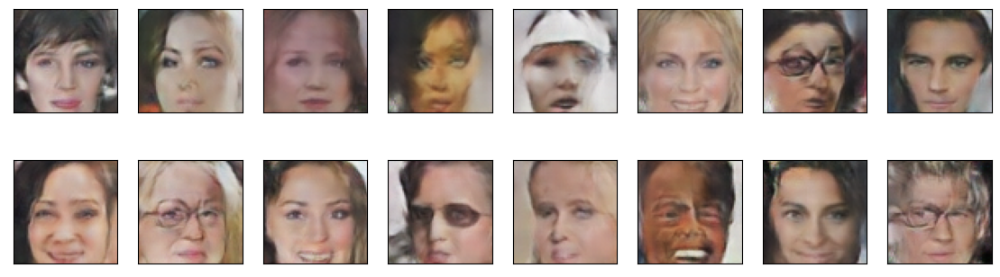

Starting Epoch [41/50]...
2024-11-01 15:10:02 | Epoch [41/50] | Batch 0/509 | d_loss: 0.0074 | g_loss: 5.3518
2024-11-01 15:10:10 | Epoch [41/50] | Batch 50/509 | d_loss: 0.3251 | g_loss: 3.6371
2024-11-01 15:10:17 | Epoch [41/50] | Batch 100/509 | d_loss: 0.0002 | g_loss: 10.3150
2024-11-01 15:10:25 | Epoch [41/50] | Batch 150/509 | d_loss: 12.0419 | g_loss: 7.7057
2024-11-01 15:10:32 | Epoch [41/50] | Batch 200/509 | d_loss: 0.4346 | g_loss: 3.0354
2024-11-01 15:10:40 | Epoch [41/50] | Batch 250/509 | d_loss: 0.3699 | g_loss: 2.6654
2024-11-01 15:10:47 | Epoch [41/50] | Batch 300/509 | d_loss: 0.5220 | g_loss: 4.9850
2024-11-01 15:10:55 | Epoch [41/50] | Batch 350/509 | d_loss: 2.7488 | g_loss: 1.4495
2024-11-01 15:11:03 | Epoch [41/50] | Batch 400/509 | d_loss: 0.3819 | g_loss: 2.6463
2024-11-01 15:11:10 | Epoch [41/50] | Batch 450/509 | d_loss: 0.0574 | g_loss: 4.6639
2024-11-01 15:11:18 | Epoch [41/50] | Batch 500/509 | d_loss: 0.0428 | g_loss: 5.3072
End of Epoch [41/50]. Generat

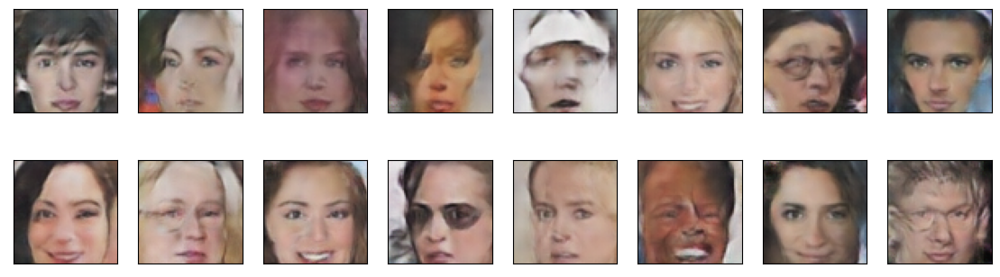

Starting Epoch [42/50]...
2024-11-01 15:11:20 | Epoch [42/50] | Batch 0/509 | d_loss: 0.5356 | g_loss: 10.4243
2024-11-01 15:11:27 | Epoch [42/50] | Batch 50/509 | d_loss: 0.0632 | g_loss: 4.0603
2024-11-01 15:11:35 | Epoch [42/50] | Batch 100/509 | d_loss: 0.1300 | g_loss: 3.7687
2024-11-01 15:11:42 | Epoch [42/50] | Batch 150/509 | d_loss: 0.1102 | g_loss: 3.3340
2024-11-01 15:11:50 | Epoch [42/50] | Batch 200/509 | d_loss: 0.3220 | g_loss: 1.8797
2024-11-01 15:11:58 | Epoch [42/50] | Batch 250/509 | d_loss: 0.3732 | g_loss: 3.9026
2024-11-01 15:12:05 | Epoch [42/50] | Batch 300/509 | d_loss: 0.0392 | g_loss: 4.3036
2024-11-01 15:12:13 | Epoch [42/50] | Batch 350/509 | d_loss: 0.1385 | g_loss: 3.6545
2024-11-01 15:12:20 | Epoch [42/50] | Batch 400/509 | d_loss: 0.2232 | g_loss: 3.1928
2024-11-01 15:12:28 | Epoch [42/50] | Batch 450/509 | d_loss: 0.0418 | g_loss: 7.5266
2024-11-01 15:12:35 | Epoch [42/50] | Batch 500/509 | d_loss: 0.1353 | g_loss: 2.5645
End of Epoch [42/50]. Generati

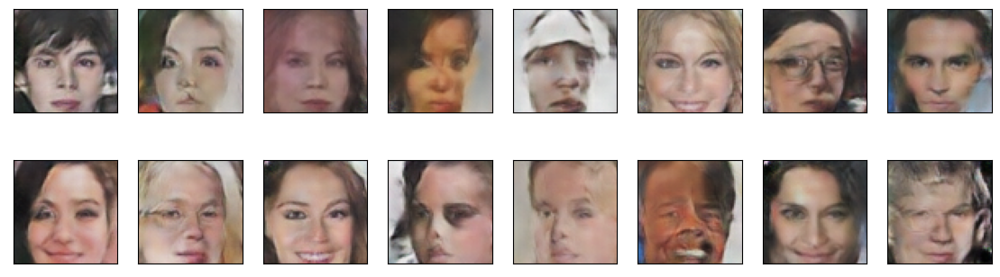

Starting Epoch [43/50]...
2024-11-01 15:12:37 | Epoch [43/50] | Batch 0/509 | d_loss: 0.0068 | g_loss: 6.5124
2024-11-01 15:12:45 | Epoch [43/50] | Batch 50/509 | d_loss: 0.1941 | g_loss: 3.6117
2024-11-01 15:12:52 | Epoch [43/50] | Batch 100/509 | d_loss: 0.0429 | g_loss: 8.0646
2024-11-01 15:13:00 | Epoch [43/50] | Batch 150/509 | d_loss: 0.1650 | g_loss: 6.1151
2024-11-01 15:13:07 | Epoch [43/50] | Batch 200/509 | d_loss: 0.0362 | g_loss: 4.1793
2024-11-01 15:13:15 | Epoch [43/50] | Batch 250/509 | d_loss: 0.0189 | g_loss: 8.3828
2024-11-01 15:13:22 | Epoch [43/50] | Batch 300/509 | d_loss: 0.0286 | g_loss: 6.0540
2024-11-01 15:13:30 | Epoch [43/50] | Batch 350/509 | d_loss: 0.1381 | g_loss: 4.3491
2024-11-01 15:13:37 | Epoch [43/50] | Batch 400/509 | d_loss: 1.2572 | g_loss: 4.1871
2024-11-01 15:13:45 | Epoch [43/50] | Batch 450/509 | d_loss: 0.1251 | g_loss: 4.3877
2024-11-01 15:13:53 | Epoch [43/50] | Batch 500/509 | d_loss: 0.0602 | g_loss: 4.2095
End of Epoch [43/50]. Generatin

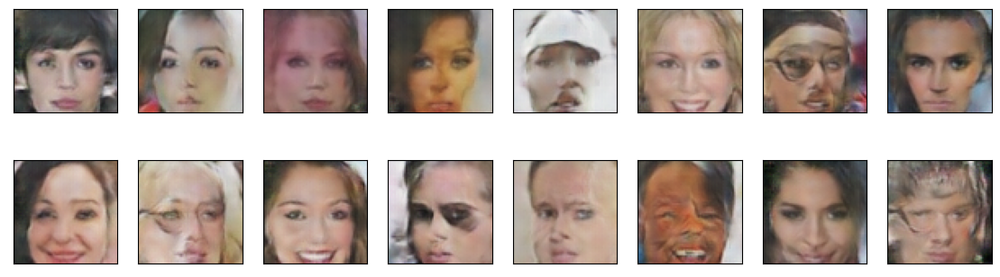

Starting Epoch [44/50]...
2024-11-01 15:13:54 | Epoch [44/50] | Batch 0/509 | d_loss: 0.0940 | g_loss: 4.6653
2024-11-01 15:14:02 | Epoch [44/50] | Batch 50/509 | d_loss: 0.0173 | g_loss: 5.7634
2024-11-01 15:14:09 | Epoch [44/50] | Batch 100/509 | d_loss: 0.0214 | g_loss: 4.2199
2024-11-01 15:14:17 | Epoch [44/50] | Batch 150/509 | d_loss: 0.1559 | g_loss: 4.4164
2024-11-01 15:14:25 | Epoch [44/50] | Batch 200/509 | d_loss: 0.0344 | g_loss: 8.4804
2024-11-01 15:14:32 | Epoch [44/50] | Batch 250/509 | d_loss: 0.0192 | g_loss: 8.4260
2024-11-01 15:14:40 | Epoch [44/50] | Batch 300/509 | d_loss: 0.0513 | g_loss: 8.5505
2024-11-01 15:14:48 | Epoch [44/50] | Batch 350/509 | d_loss: 0.0331 | g_loss: 6.2316
2024-11-01 15:14:55 | Epoch [44/50] | Batch 400/509 | d_loss: 0.0090 | g_loss: 6.7072
2024-11-01 15:15:03 | Epoch [44/50] | Batch 450/509 | d_loss: 0.0268 | g_loss: 5.1440
2024-11-01 15:15:10 | Epoch [44/50] | Batch 500/509 | d_loss: 0.0177 | g_loss: 7.8424
End of Epoch [44/50]. Generatin

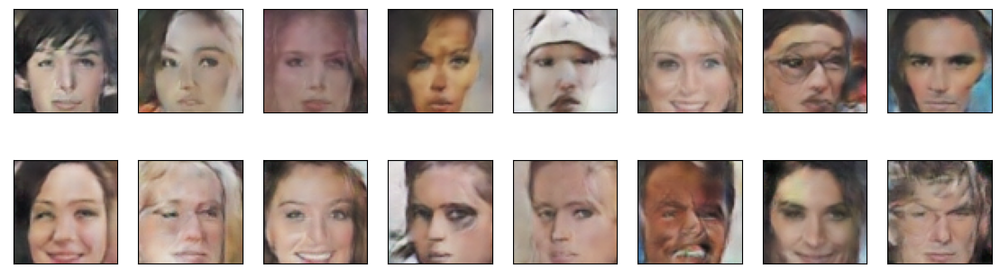

Starting Epoch [45/50]...
2024-11-01 15:15:12 | Epoch [45/50] | Batch 0/509 | d_loss: 0.0059 | g_loss: 6.1764
2024-11-01 15:15:20 | Epoch [45/50] | Batch 50/509 | d_loss: 0.0081 | g_loss: 6.5414
2024-11-01 15:15:27 | Epoch [45/50] | Batch 100/509 | d_loss: 0.0044 | g_loss: 10.0890
2024-11-01 15:15:35 | Epoch [45/50] | Batch 150/509 | d_loss: 0.0744 | g_loss: 4.2106
2024-11-01 15:15:43 | Epoch [45/50] | Batch 200/509 | d_loss: 0.1322 | g_loss: 3.6902
2024-11-01 15:15:50 | Epoch [45/50] | Batch 250/509 | d_loss: 0.2730 | g_loss: 2.7917
2024-11-01 15:15:58 | Epoch [45/50] | Batch 300/509 | d_loss: 0.0144 | g_loss: 7.8170
2024-11-01 15:16:05 | Epoch [45/50] | Batch 350/509 | d_loss: 0.0180 | g_loss: 5.1652
2024-11-01 15:16:13 | Epoch [45/50] | Batch 400/509 | d_loss: 0.0843 | g_loss: 2.4813
2024-11-01 15:16:21 | Epoch [45/50] | Batch 450/509 | d_loss: 0.2285 | g_loss: 5.2815
2024-11-01 15:16:28 | Epoch [45/50] | Batch 500/509 | d_loss: 0.0181 | g_loss: 5.0382
End of Epoch [45/50]. Generati

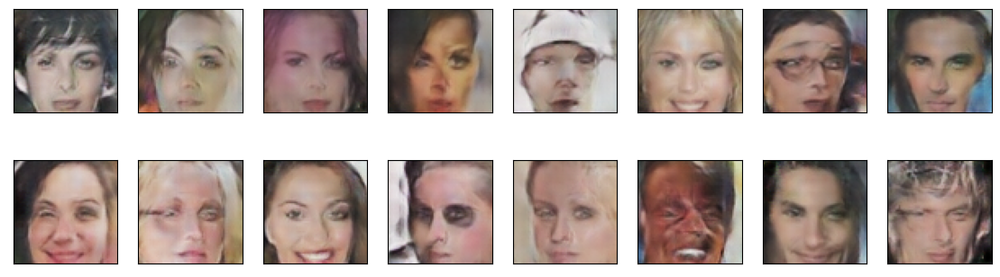

Starting Epoch [46/50]...
2024-11-01 15:16:30 | Epoch [46/50] | Batch 0/509 | d_loss: 0.0075 | g_loss: 6.6061
2024-11-01 15:16:38 | Epoch [46/50] | Batch 50/509 | d_loss: 0.0151 | g_loss: 6.8555
2024-11-01 15:16:45 | Epoch [46/50] | Batch 100/509 | d_loss: 0.0978 | g_loss: 4.5161
2024-11-01 15:16:53 | Epoch [46/50] | Batch 150/509 | d_loss: 0.0157 | g_loss: 4.9556
2024-11-01 15:17:00 | Epoch [46/50] | Batch 200/509 | d_loss: 0.0728 | g_loss: 4.3288
2024-11-01 15:17:08 | Epoch [46/50] | Batch 250/509 | d_loss: 0.0209 | g_loss: 4.4074
2024-11-01 15:17:16 | Epoch [46/50] | Batch 300/509 | d_loss: 0.0648 | g_loss: 2.9880
2024-11-01 15:17:24 | Epoch [46/50] | Batch 350/509 | d_loss: 0.2287 | g_loss: 5.5077
2024-11-01 15:17:31 | Epoch [46/50] | Batch 400/509 | d_loss: 0.0029 | g_loss: 6.6153
2024-11-01 15:17:39 | Epoch [46/50] | Batch 450/509 | d_loss: 5.9264 | g_loss: 9.0289
2024-11-01 15:17:47 | Epoch [46/50] | Batch 500/509 | d_loss: 0.0098 | g_loss: 6.0884
End of Epoch [46/50]. Generatin

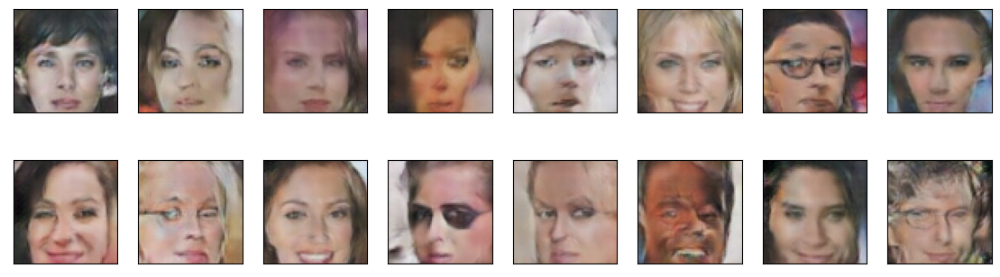

Starting Epoch [47/50]...
2024-11-01 15:17:49 | Epoch [47/50] | Batch 0/509 | d_loss: 0.0994 | g_loss: 8.6601
2024-11-01 15:17:56 | Epoch [47/50] | Batch 50/509 | d_loss: 0.2214 | g_loss: 4.2512
2024-11-01 15:18:04 | Epoch [47/50] | Batch 100/509 | d_loss: 0.0069 | g_loss: 5.6015
2024-11-01 15:18:12 | Epoch [47/50] | Batch 150/509 | d_loss: 0.0762 | g_loss: 6.7202
2024-11-01 15:18:20 | Epoch [47/50] | Batch 200/509 | d_loss: 0.0138 | g_loss: 6.4521
2024-11-01 15:18:27 | Epoch [47/50] | Batch 250/509 | d_loss: 0.4671 | g_loss: 4.3723
2024-11-01 15:18:35 | Epoch [47/50] | Batch 300/509 | d_loss: 0.0167 | g_loss: 7.8171
2024-11-01 15:18:43 | Epoch [47/50] | Batch 350/509 | d_loss: 0.0242 | g_loss: 5.5706
2024-11-01 15:18:51 | Epoch [47/50] | Batch 400/509 | d_loss: 0.0788 | g_loss: 5.4861
2024-11-01 15:18:58 | Epoch [47/50] | Batch 450/509 | d_loss: 0.0024 | g_loss: 6.6016
2024-11-01 15:19:06 | Epoch [47/50] | Batch 500/509 | d_loss: 0.0044 | g_loss: 8.3591
End of Epoch [47/50]. Generatin

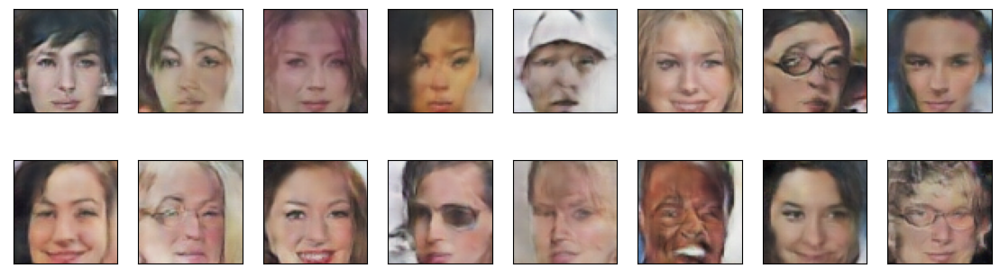

Starting Epoch [48/50]...
2024-11-01 15:19:08 | Epoch [48/50] | Batch 0/509 | d_loss: 0.1148 | g_loss: 6.1898
2024-11-01 15:19:16 | Epoch [48/50] | Batch 50/509 | d_loss: 0.2752 | g_loss: 2.8917
2024-11-01 15:19:24 | Epoch [48/50] | Batch 100/509 | d_loss: 0.5576 | g_loss: 8.5234
2024-11-01 15:19:31 | Epoch [48/50] | Batch 150/509 | d_loss: 0.0115 | g_loss: 4.2563
2024-11-01 15:19:39 | Epoch [48/50] | Batch 200/509 | d_loss: 0.1220 | g_loss: 4.8535
2024-11-01 15:19:47 | Epoch [48/50] | Batch 250/509 | d_loss: 0.0245 | g_loss: 6.0517
2024-11-01 15:19:55 | Epoch [48/50] | Batch 300/509 | d_loss: 0.0867 | g_loss: 5.9111
2024-11-01 15:20:02 | Epoch [48/50] | Batch 350/509 | d_loss: 0.0456 | g_loss: 8.3423
2024-11-01 15:20:10 | Epoch [48/50] | Batch 400/509 | d_loss: 0.3698 | g_loss: 3.9009
2024-11-01 15:20:18 | Epoch [48/50] | Batch 450/509 | d_loss: 0.1259 | g_loss: 3.9920
2024-11-01 15:20:26 | Epoch [48/50] | Batch 500/509 | d_loss: 0.9063 | g_loss: 1.8532
End of Epoch [48/50]. Generatin

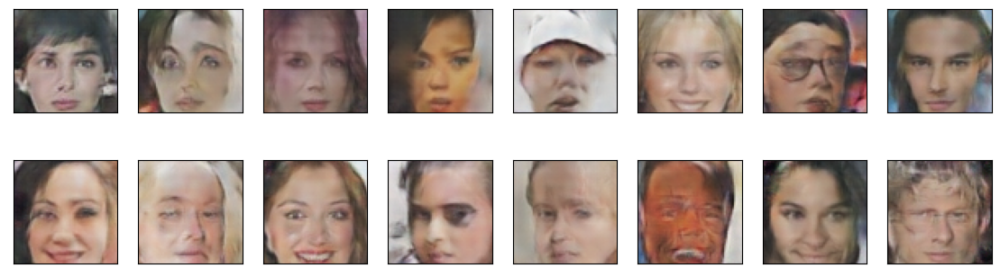

Starting Epoch [49/50]...
2024-11-01 15:20:27 | Epoch [49/50] | Batch 0/509 | d_loss: 0.0842 | g_loss: 5.2630
2024-11-01 15:20:35 | Epoch [49/50] | Batch 50/509 | d_loss: 0.0058 | g_loss: 6.2321
2024-11-01 15:20:43 | Epoch [49/50] | Batch 100/509 | d_loss: 0.0431 | g_loss: 5.6870
2024-11-01 15:20:50 | Epoch [49/50] | Batch 150/509 | d_loss: 0.0397 | g_loss: 4.6098
2024-11-01 15:20:58 | Epoch [49/50] | Batch 200/509 | d_loss: 0.0348 | g_loss: 8.2735
2024-11-01 15:21:06 | Epoch [49/50] | Batch 250/509 | d_loss: 0.0771 | g_loss: 3.8094
2024-11-01 15:21:14 | Epoch [49/50] | Batch 300/509 | d_loss: 0.0384 | g_loss: 3.8391
2024-11-01 15:21:21 | Epoch [49/50] | Batch 350/509 | d_loss: 0.0297 | g_loss: 4.9051
2024-11-01 15:21:29 | Epoch [49/50] | Batch 400/509 | d_loss: 0.6723 | g_loss: 1.0063
2024-11-01 15:21:37 | Epoch [49/50] | Batch 450/509 | d_loss: 0.0394 | g_loss: 4.5893
2024-11-01 15:21:44 | Epoch [49/50] | Batch 500/509 | d_loss: 0.0404 | g_loss: 4.4063
End of Epoch [49/50]. Generatin

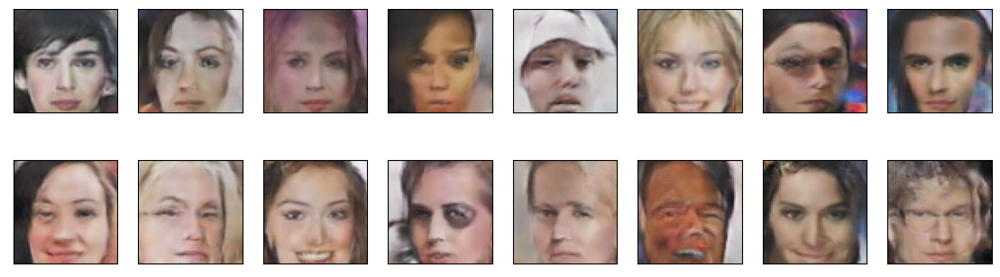

Starting Epoch [50/50]...
2024-11-01 15:21:46 | Epoch [50/50] | Batch 0/509 | d_loss: 0.0040 | g_loss: 5.9250
2024-11-01 15:21:54 | Epoch [50/50] | Batch 50/509 | d_loss: 0.1345 | g_loss: 3.7740
2024-11-01 15:22:01 | Epoch [50/50] | Batch 100/509 | d_loss: 0.0050 | g_loss: 6.1845
2024-11-01 15:22:09 | Epoch [50/50] | Batch 150/509 | d_loss: 0.1414 | g_loss: 6.9168
2024-11-01 15:22:17 | Epoch [50/50] | Batch 200/509 | d_loss: 0.2902 | g_loss: 4.8234
2024-11-01 15:22:25 | Epoch [50/50] | Batch 250/509 | d_loss: 0.2884 | g_loss: 7.3518
2024-11-01 15:22:32 | Epoch [50/50] | Batch 300/509 | d_loss: 0.1104 | g_loss: 3.7194
2024-11-01 15:22:40 | Epoch [50/50] | Batch 350/509 | d_loss: 0.0912 | g_loss: 5.6616
2024-11-01 15:22:48 | Epoch [50/50] | Batch 400/509 | d_loss: 0.1354 | g_loss: 4.7980
2024-11-01 15:22:56 | Epoch [50/50] | Batch 450/509 | d_loss: 0.0154 | g_loss: 4.8416
2024-11-01 15:23:03 | Epoch [50/50] | Batch 500/509 | d_loss: 0.0040 | g_loss: 9.0911
End of Epoch [50/50]. Generatin

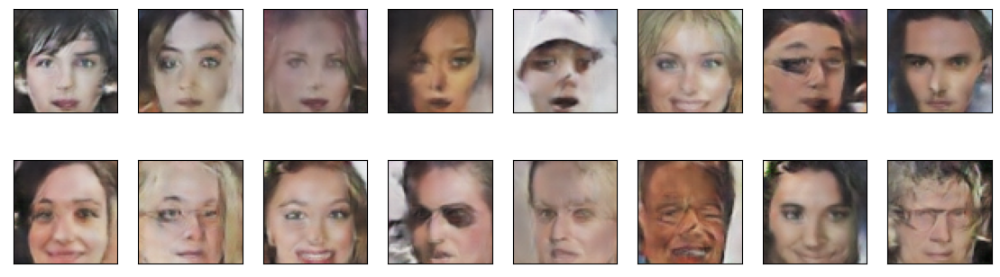

Training complete.


In [19]:
# fixed_latent_vector = torch.randn(16, latent_dim, 1, 1).float().cuda()

# losses = []
# for epoch in range(n_epochs):
#     for batch_i, real_images in enumerate(dataloader):
#         real_images = real_images.to(device)
        
#         ####################################
        
#         # TODO: implement the training strategy
        
#         ####################################
        
#         if batch_i % print_every == 0:
#             # append discriminator loss and generator loss
#             d = d_loss['loss'].item()
#             g = g_loss['loss'].item()
#             losses.append((d, g))
#             # print discriminator and generator loss
#             time = str(datetime.now()).split('.')[0]
#             print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d:.4f} | g_loss: {g:.4f}')
    
#     # display images during training
#     generator.eval()
#     generated_images = generator(fixed_latent_vector)
#     display(generated_images)
#     generator.train()


# ––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––
# from datetime import datetime
# 
# # Fixed latent vector for visualizing generator's progress
# fixed_latent_vector = torch.randn(16, latent_dim, 1, 1).to(device)
# 
# losses = []
# for epoch in range(n_epochs):
#     for batch_i, real_images in enumerate(dataloader):
#         real_images = real_images.to(device)
# 
#         ####################################
#         # Train the discriminator
#         d_loss = discriminator_step(
#             generator, discriminator, d_optimizer, 
#             batch_size, latent_dim, real_images, device
#         )
# 
#         # Train the generator twice for better convergence
#         g_loss = generator_step(
#             generator, discriminator, g_optimizer, 
#             batch_size, latent_dim, device
#         )
#         # g_loss = generator_step(
#         #     generator, discriminator, g_optimizer, 
#         #     batch_size, latent_dim, device
#         # )
#         ####################################
# 
#         if batch_i % print_every == 0:
#             # Append discriminator and generator losses
#             d = d_loss['loss'].item()
#             g = g_loss['loss'].item()
#             losses.append((d, g))
# 
#             # Print loss details
#             time = str(datetime.now()).split('.')[0]
#             print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d:.4f} | g_loss: {g:.4f}')
# 
#     # Display images during training
#     generator.eval()
#     generated_images = generator(fixed_latent_vector)
#     display(generated_images)
#     generator.train()


from datetime import datetime

# Fixed latent vector for visualizing generator's progress
fixed_latent_vector = torch.randn(16, latent_dim, 1, 1).to(device)

losses = []
for epoch in range(n_epochs):
    print(f"Starting Epoch [{epoch+1}/{n_epochs}]...")  # Start of each epoch
    
    for batch_i, real_images in enumerate(dataloader):
        real_images = real_images.to(device)

        ####################################
        # Train the discriminator
        d_loss = discriminator_step(
            generator, discriminator, d_optimizer, 
            batch_size, latent_dim, real_images, device
        )

        # Train the generator twice for better convergence
        g_loss = generator_step(
            generator, discriminator, g_optimizer, 
            batch_size, latent_dim, device
        )
        # Uncomment if you need a second generator step
        # g_loss = generator_step(
        #     generator, discriminator, g_optimizer, 
        #     batch_size, latent_dim, device
        # )
        ####################################

        if batch_i % print_every == 0:
            # Append discriminator and generator losses
            d = d_loss['loss'].item()
            g = g_loss['loss'].item()
            losses.append((d, g))

            # Print loss details
            time = str(datetime.now()).split('.')[0]
            print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d:.4f} | g_loss: {g:.4f}')
    
    # Display images during training
    print(f"End of Epoch [{epoch+1}/{n_epochs}]. Generating sample images...")
    generator.eval()
    generated_images = generator(fixed_latent_vector)
    display(generated_images)
    generator.train()

print("Training complete.")



        


### Training losses

Plot the training losses for the generator and discriminator.

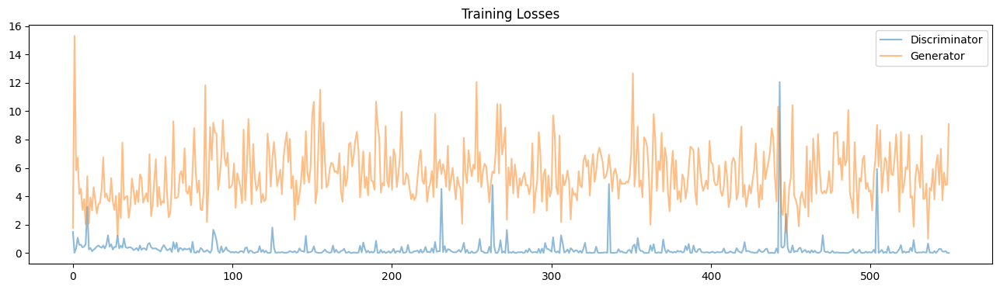

In [20]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# fig, ax = plt.subplots()
# losses = np.array(losses)
# plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
# plt.plot(losses.T[1], label='Generator', alpha=0.5)
# plt.title("Training Losses")
# plt.legend()


fig, ax = plt.subplots(figsize=(16,4))
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()


### Question: What do you notice about your generated samples and how might you improve this model?
When you answer this question, consider the following factors:
* The dataset is biased; it is made of "celebrity" faces that are mostly white
* Model size; larger models have the opportunity to learn more features in a data feature space
* Optimization strategy; optimizers and number of epochs affect your final result
* Loss functions

**Answer:** (Write your answer in this cell)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb".  

Submit the notebook using the ***SUBMIT*** button in the bottom right corner of the Project Workspace.